In [1]:
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
#from gprofiler import gprofiler

import os

# Define the path to the directory you want to change to
new_directory = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/MM_sysVI'

# Use os.chdir() to change the working directory
os.chdir(new_directory)

In [2]:
#### NEW COLORS FOR PLOTTING GENE EXPRESSION ON UMAPS

import matplotlib.pyplot as plt
import matplotlib.colors as colors
import numpy as np
import scanpy as sc

# Define a nice color map for gene expression
colors2 = plt.cm.PuRd(np.linspace(0, 1, 128))  # Use PuRd color map for deep red/purple color
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))  # Greys for low values
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [4]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12) #color_map=mymap2)
sc.settings.figdir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/MM_sysVI/figures/'
sc.logging.print_header()

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


# Reload adata_ol_mouse_all

In [5]:
# All integrated
adata_all = sc.read_h5ad('/scratch365/eaboelno/BACKUP_h5ad_IMPORTANT/adata_mm_all_annot_UPDATED.h5ad')
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

In [8]:
pd.set_option('display.max_columns', None)
adata_all.obs[:5]

,sample_id,publication,sample_id_anon,individual_id_anon,replicate,treatment,condition,tissue,time,batch,lesion_type,sample_source,diagnosis,n_genes_by_counts,total_counts,pct_counts_mt,pct_counts_ribo,s_score,g2m_score,phase,type_fine,type_broad,cluster_zoom,exclude_pseudobulk,seq_pool,sex,age_at_death,smoker,cause_of_death,years_w_ms,pmi_minutes,age_scale,age_cat,pmi_cat,pmi_cat2,cell_cycle_diff,cell_type_eval,library_type,sample_type,organism,system,system_map,sys_leiden_0.5,sys_leiden_1,sys_leiden_1.5,sys_leiden_2,indiv_treatment_time,lesion_status,lesion_condition,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_ribo,log1p_total_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,Microglia,DAM,Macrophages,BAM,Monocytes,DCs,NKT cells,T cells,B cells,Neutrophils,Neurons,OPCs,COPs,MOL,Astrocytes,Pericytes,VSMCs,VLMCs,VECV,S_score,G2M_score,Cycling cells,S phase,Cycling_cells,S_phase_cells,cluster_annotation,cell_leiden_annotated,Neuroblasts,Endothelial,Choroid plexus,Ependymal,common_innate_immunity_signature,IRAS1,IRAS2,refined_cluster_annotation,MOLs_highlight
barcode,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
GTATTTCGTCCACATA-1_adams,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3795,3382.139404,0.013428,0.185341,-0.160523,-0.120577,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.039946,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,sn-mouse,14,16,21,22,(this study)_LPC_7dpl,LPC_demyel,LPC_demyelination,8.241703,8.126559,2.727820,6.268486,1.983548,0.513965,0.414732,0.015196,-1.953571,-2.64,-1.157895,-0.145,-0.106667,-0.586000,-0.120805,-0.020000,-0.015075,-1.26,14.748185,-0.73,-0.42,-1.74,-1.334677,-0.713333,-0.395,-0.336,-0.798387,-0.523961,-0.521121,-0.519072,-0.488964,resting,NA,Excitatory neurons,16_Excitatory neurons,0.47,-0.458194,-0.224490,-0.42,-0.860867,-0.691643,-1.607209,Excitatory neurons,Other
ATACCTTGTCGACGCT-1_adams,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3737,3427.815918,0.000000,0.204514,-0.137565,-0.107280,G1,TBD,inhibitory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.030285,inhibitory neurons,10X 3p kit v3.1,sn,mouse,0,sn-mouse,16,23,31,35,(this study)_LPC_7dpl,LPC_demyel,LPC_demyelination,8.226306,8.139970,2.564160,7.010375,2.080738,0.000000,0.000000,0.000000,-2.688571,-3.28,-1.052632,-0.145,-0.080000,-0.614000,-0.120805,2.033333,-0.020101,-0.32,28.770240,-0.28,-0.25,-3.22,-1.479839,-0.386667,-0.465,-0.336,-0.491935,-0.499242,-0.655826,-0.630079,-0.452207,resting,NA,Inhibitory neurons,23_Inhibitory neurons,-0.53,-0.357860,-0.204082,-0.25,-1.385906,-0.565459,-1.730955,Inhibitory neurons,Other
TCAAGACGTGCTGCAC-1_adams,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4382,3822.165527,0.026985,0.256134,-0.147916,-0.150035,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.002119,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,sn-mouse,14,16,21,22,(this study)_LPC_7dpl,LPC_demyel,LPC_demyelination,8.385489,8.248834,2.286428,9.789854,2.378606,1.031943,0.708992,0.026999,-1.718571,-3.40,-0.992481,-0.280,-0.073333,-0.548000,-0.167785,0.193333,-0.020101,-0.66,21.497767,-0.53,-0.51,-1.43,-1.145161,-1.006667,-0.535,-0.468,-0.995968,-0.492417,-0.625645,-0.578806,-0.477668,resting,NA,Excitatory neurons,16_Excitatory neurons,0.43,-0.441472,-0.183673,-0.51,-0.810532,-0.717579,-1.742289,Excitatory neurons,Other
AGTACTGTCAAGTAAG-1_adams,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4562,3954.899170,0.020542,0.345357,-0.132352,-0.172023,G1,TBD,excitatory neur

In [9]:
# Define the order for lesion_type
lesion_order = ['LPC_baseline', 'LPC_demyel', 'LPC_mid_remyel', 'LPC_remyel', 'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']

# Convert the lesion_type column to a categorical type with the specified order
adata_all.obs['lesion_status'] = pd.Categorical(adata_all.obs['lesion_status'], categories=lesion_order, ordered=True)

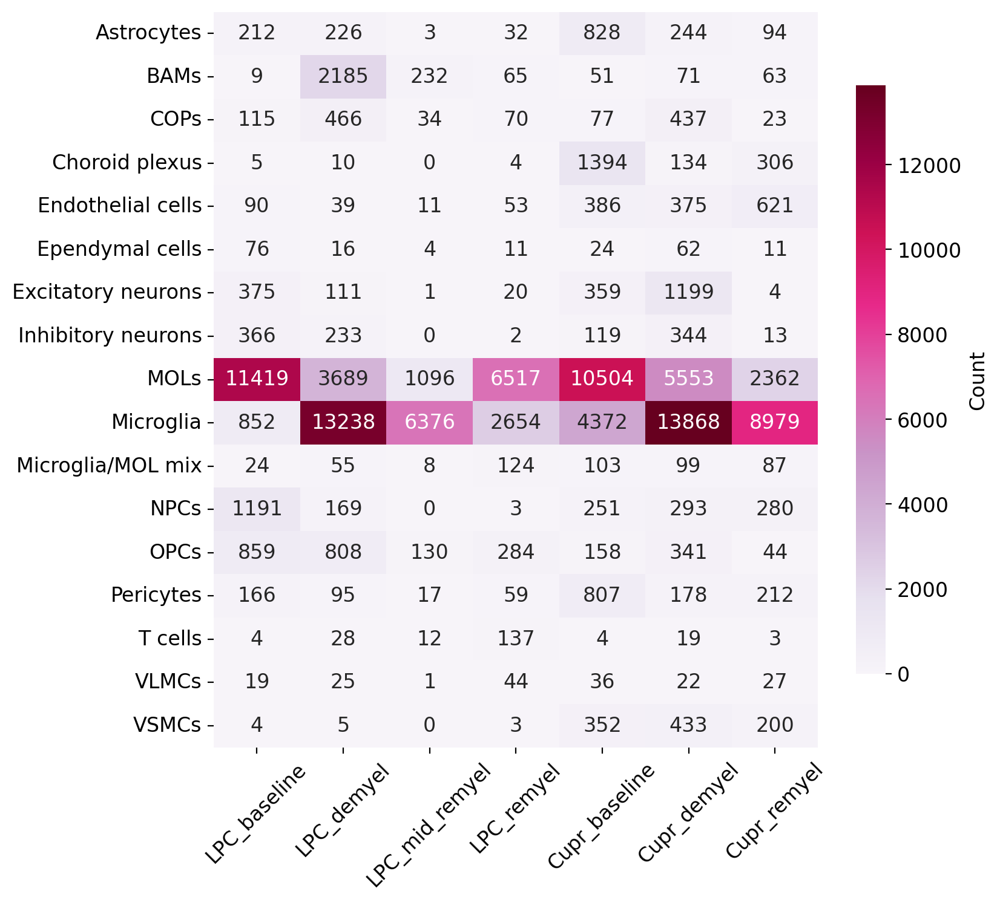

In [10]:
crosstab_df = pd.crosstab(adata_all.obs.cluster_annotation, adata_all.obs.lesion_status)

# Create the heatmap with integer annotations
plt.figure(figsize=(8, 8))  # Adjust the figure size to make it more square
#ax = sb.heatmap(crosstab_df, cmap="PuRd", annot=True, fmt="d", cbar=False, square=False)

ax = sb.heatmap(
    crosstab_df, 
    cmap="PuRd", 
    annot=True, 
    fmt="d", 
    cbar=True,  # Enable color bar (scale bar)
    square=False, 
    cbar_kws={"shrink": 0.8, "label": "Count"}  # Customize color bar
)

# Remove grid lines
ax.grid(False)

# Remove axis labels (titles)
ax.set_xlabel(None)
ax.set_ylabel(None)

# Rotate tick labels for better visibility
ax.tick_params(axis='x', rotation=45)
ax.tick_params(axis='y', rotation=0)

# Alternatively, for vector graphics format
plt.savefig('./figures/crosstab_cluster_annotation_vs_lesion_all.png', dpi=300, bbox_inches='tight')

# Show the heatmap
plt.show()

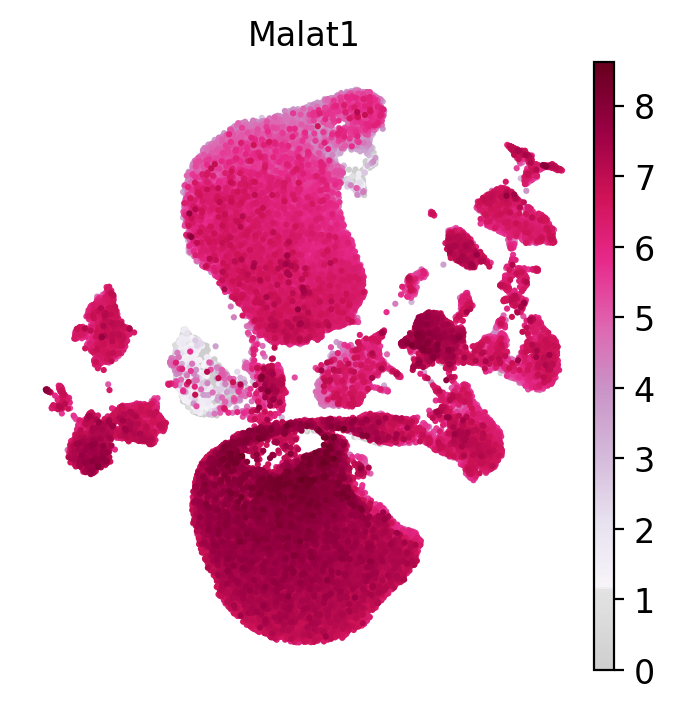

In [7]:
# Define a nice color map for gene expression
colors2 = plt.cm.PuRd(np.linspace(0, 1, 128))  # Use PuRd color map for deep red/purple color
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))  # Greys for low values
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)


sc.pl.embedding(
    adata_all,
    basis='X_umap',
    color=['Malat1'],
    frameon=False,
    layer='log1p_norm',
    color_map=mymap,
    size=20,
    legend_fontsize = 'xx-large',
    legend_loc='on data',
    save='Malat1_expression'
)

In [5]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['treatment'].unique()
for condition in unique_conditions:
    print(condition)

LPC
Saline
Cuprizone
Normal
No lesion


In [6]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['condition'].unique()
for condition in unique_conditions:
    print(condition)

Demyelination
Control
Remyelination (late)
Remyelination (early)
Remyelination


In [7]:
adata_all.obs['publication'] = adata_all.obs['publication'].astype(str)
adata_all.obs['treatment'] = adata_all.obs['treatment'].astype(str)
adata_all.obs['time'] = adata_all.obs['time'].astype(str)
adata_all.obs['indiv_treatment_time'] = adata_all.obs['publication'] + '_' + adata_all.obs['treatment'] + '_' + adata_all.obs['time']

In [6]:
# Define the mapping dictionary for the remaining values in 'treatment_meta'
treatment_map = {
    '(this study)_LPC_7dpl': 'LPC_demyelination_7d',
    '(this study)_Saline_Baseline': 'LPC_saline',
    '(this study)_Cuprizone_5 weeks': 'Cuprizone_demyelination_5w',
    '(this study)_Normal_Baseline': 'Cuprizone_baseline_adams',
    'Pandey et al. 2022_LPC_5dpl': 'LPC_demyelination_5d',
    'Pandey et al. 2022_LPC_28dpl': 'LPC_remyelination_28d',
    'Pandey et al. 2022_No lesion_Baseline': 'LPC_no_lesion',
    'Pandey et al. 2022_LPC_14dpl': 'LPC_demyelination_14d',
    'Shen et al. 2021_Cuprizone_4+3 weeks': 'Cuprizone_remyelination_4+3w',
    'Shen et al. 2021_Cuprizone_4 weeks': 'Cuprizone_demyelination_4w',
    'Shen et al. 2021_Normal_Baseline': 'Cuprizone_baseline'
}

# Update the 'treatment_meta' column based on the mapping
adata_all.obs['lesion_status'] = adata_all.obs['indiv_treatment_time'].map(treatment_map)

In [9]:
# Define the mapping dictionary for the remaining values in 'treatment_meta'
treatment_map = {
    'LPC_demyelination_7d': 'LPC_demyelination',
    'LPC_saline': 'baseline',
    'Cuprizone_demyelination_5w': 'cuprizone_demyelination',
    'Cuprizone_baseline_adams': 'baseline',
    'LPC_demyelination_5d': 'LPC_demyelination',
    'LPC_remyelination_28d': 'LPC_late_remyelination',
    'LPC_no_lesion': 'baseline',
    'LPC_demyelination_14d': 'LPC_early_remyelination',
    'Cuprizone_remyelination_4+3w': 'cuprizone_remyelination',
    'Cuprizone_demyelination_4w': 'cuprizone_demyelination',
    'Cuprizone_baseline': 'baseline'
}

# Update the 'treatment_meta' column based on the mapping
adata_all.obs['lesion_condition'] = adata_all.obs['lesion_status'].map(treatment_map)

In [11]:
adata_all.obs['lesion_condition'].value_counts()

lesion_condition
baseline                   35611
cuprizone_demyelination    23672
LPC_demyelination          21398
cuprizone_remyelination    13329
LPC_late_remyelination     10082
LPC_early_remyelination     7925
Name: count, dtype: int64

# Some QC calcs

In [12]:
adata_all2=adata_all.copy()

In [13]:
adata_all.var["hb"] = adata_all.var_names.str.contains(("Hb"))
adata_all.var["ribo"] = adata_all.var_names.str.startswith(("Rps", "Rpl"))

In [14]:
sc.pp.calculate_qc_metrics(
    adata_all, qc_vars=["ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'hb', 'ribo', 'n_cell

In [15]:
for i in ['total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb']:
    adata_all2.obs[i]=adata_all.obs[i]

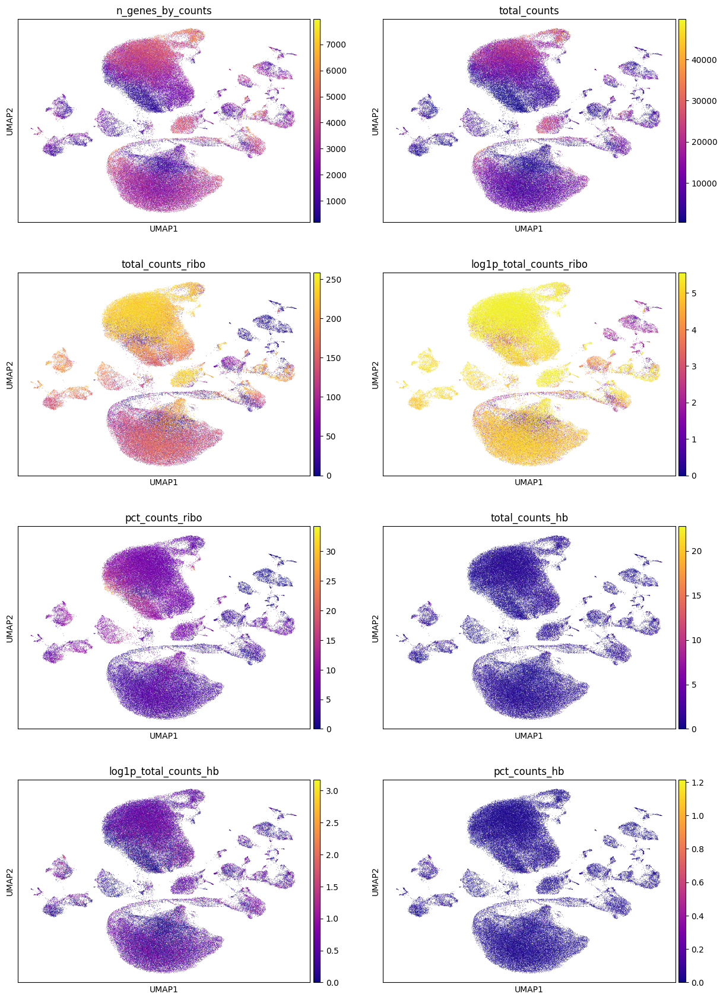

In [21]:
sc.pl.umap(adata_all2, color=['n_genes_by_counts', 'total_counts', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 
                              'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'], cmap='plasma',ncols=2)

# Add cell cycle analysis

In [37]:
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

In [62]:
cell_cycle_genes = [x.strip() for x in open('/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/regev_lab_cell_cycle_genes.txt')]

In [63]:
cell_cycle_genes = [gene.capitalize() for gene in cell_cycle_genes]

In [64]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

In [ ]:
# Convert genes to the desired format
s_genes_formatted = [gene.capitalize() for gene in s_genes]
g2m_genes_formatted = [gene.capitalize() for gene in g2m_genes]

In [65]:
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_all.var_names]

In [66]:
sc.tl.score_genes_cell_cycle(adata_all, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    471 total control genes are used. (0:00:02)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    641 total control genes are used. (0:00:02)
-->     'phase', cell cycle phase (adata.obs)


In [67]:
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

In [39]:
pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]

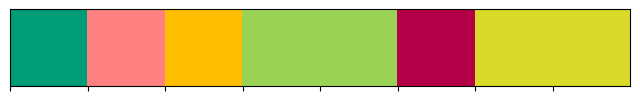

In [40]:
sb.palplot(pair2)

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


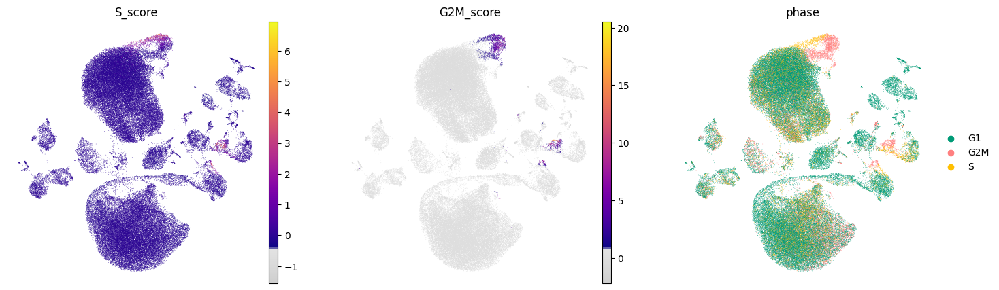

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


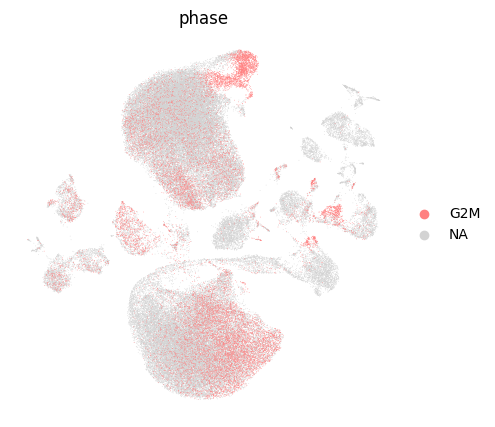

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


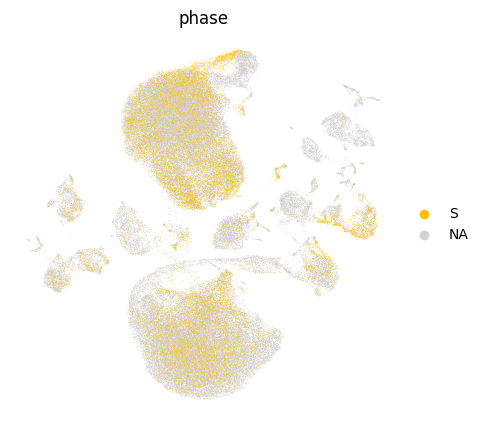

In [68]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.umap(adata_all, color=['S_score', 'G2M_score', 'phase'],palette=pair2, use_raw=False, frameon=False, cmap=mymap2)
sc.pl.umap(adata_all, color='phase',groups=['G2M'],  palette=pair2, use_raw=False, frameon=False)
sc.pl.umap(adata_all, color='phase',groups=['S'],  palette=pair2, use_raw=False, frameon=False)

In [69]:
sc.tl.score_genes(adata_all, list(cell_cycle_genes), score_name='Cycling cells' )

computing score 'Cycling cells'
    finished: added
    'Cycling cells', score of gene set (adata.obs).
    743 total control genes are used. (0:00:02)


In [70]:
sc.tl.score_genes(adata_all, list(s_genes), score_name='S phase' )

computing score 'S phase'
    finished: added
    'S phase', score of gene set (adata.obs).
    548 total control genes are used. (0:00:02)


In [71]:
Ccc = adata_all.obs['Cycling cells'] >0

In [72]:
adata_all.obs['Cycling_cells'] = Ccc
adata_all.obs['Cycling_cells'] = adata_all.obs['Cycling_cells'].astype('category')

In [73]:
cluster2annotation = {
    False : 'resting',
    True : 'cycling',
 }

In [74]:
adata_all.obs['Cycling_cells'] = adata_all.obs['Cycling_cells'].map(cluster2annotation).astype('category')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


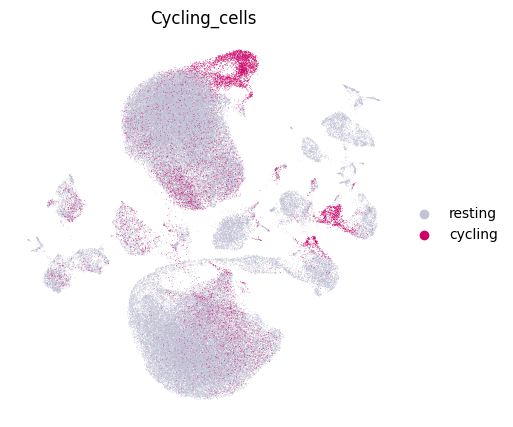

In [75]:
sc.pl.umap(adata_all, color=['Cycling_cells'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [76]:
scells = adata_all.obs['S phase'] >0.05

In [77]:
adata_all.obs['S_phase_cells'] = scells
adata_all.obs['S_phase_cells'] = adata_all.obs['S_phase_cells'].astype('category')

In [78]:
cluster2annotation = {
    False : 'NA',
    True : 'S phase',
 }

In [79]:
adata_all.obs['S_phase_cells'] = adata_all.obs['S_phase_cells'].map(cluster2annotation).astype('category')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


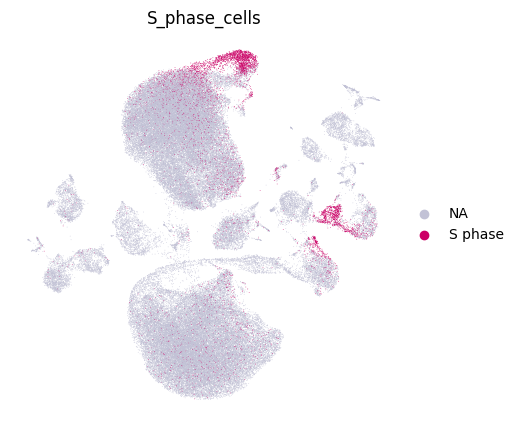

In [80]:
sc.pl.umap(adata_all, color=['S_phase_cells'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

## Cluster nomenclature

In [5]:
adata_all = sc.read('./mm_adata_all_annot_UPDATED.h5ad')
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

In [61]:
cluster_1_annotation = {
    '0': 'Microglia',
    '1': 'MOLs',
    '2': 'Microglia',
    '3': 'MOLs',
    '4': 'Microglia',
    '5': 'MOLs',
    '6': 'Microglia',
    '7': 'MOLs',
    '8': 'Microglia',
    '9': 'Microglia',
    '10': 'MOLs',
    '11': 'MOLs',
    '12': 'BAMs',
    '13': 'OPCs',
    '14': 'NPCs',
    '15': 'Choroid plexus',
    '16': 'Excitatory neurons',
    '17': 'Astrocytes',
    '18': 'Endothelial cells',
    '19': 'Pericytes',
    '20': 'COPs',
    '21': 'Microglia',
    '22': 'VSMCs',
    '23': 'Inhibitory neurons',
    '24': 'Inhibitory neurons',
    '25': 'Microglia/MOL mix',
    '26': 'Microglia',
    '27': 'Excitatory neurons',
    '28': 'T cells',
    '29': 'Ependymal cells',
    '30': 'Microglia',
    '31': 'VLMCs'
}

In [62]:
adata_all.obs['cluster_annotation'] = adata_all.obs['sys_leiden_1'].map(cluster_1_annotation).astype('category')

In [63]:
adata_all.obs['cluster_annotation'].value_counts()

cluster_annotation
Microglia             50339
MOLs                  41140
BAMs                   2676
OPCs                   2624
NPCs                   2187
Excitatory neurons     2069
Choroid plexus         1853
Astrocytes             1639
Endothelial cells      1575
Pericytes              1534
COPs                   1222
Inhibitory neurons     1077
VSMCs                   997
Microglia/MOL mix       500
T cells                 207
Ependymal cells         204
VLMCs                   174
Name: count, dtype: int64

In [71]:
cluster2annotation = {
    '0': '0_Microglia',
    '1': '1_MOLs',
    '2': '2_Microglia',
    '3': '3_MOLs',
    '4': '4_Microglia',
    '5': '5_MOLs',
    '6': '6_Microglia',
    '7': '7_MOLs',
    '8': '8_Microglia',
    '9': '9_Microglia',
    '10': '10_MOLs',
    '11': '11_MOLs',
    '12': '12_BAMs',
    '13': '13_OPCs',
    '14': '14_NPCs',
    '15': '15_Choroid plexus',
    '16': '16_Excitatory neurons',
    '17': '17_Astrocytes',
    '18': '18_Endothelial cells',
    '19': '19_Pericytes',
    '20': '20_COPs',
    '21': '21_Microglia',
    '22': '22_VSMCs',
    '23': '23_Inhibitory neurons',
    '24': '24_Inhibitory neurons',
    '25': '25_Microglia/MOL mix',
    '26': '26_Microglia',
    '27': '27_Excitatory neurons', 
    '28': '28_T cells',
    '29': '29_Ependymal cells',
    '30': '30_Microglia',
    '31': '31_VLMCs'
}

In [72]:
adata_all.obs['cell_leiden_annotated'] = adata_all.obs['sys_leiden_1'].map(cluster2annotation).astype('category')

In [73]:
adata_all.obs['cell_leiden_annotated'].value_counts()

cell_leiden_annotated
0_Microglia              13990
1_MOLs                   10538
2_Microglia              10382
3_MOLs                    9880
4_Microglia               9255
5_MOLs                    7345
6_Microglia               5519
7_MOLs                    5176
8_Microglia               4945
9_Microglia               4351
10_MOLs                   4298
11_MOLs                   3903
12_BAMs                   2676
13_OPCs                   2624
14_NPCs                   2187
15_Choroid plexus         1853
16_Excitatory neurons     1640
17_Astrocytes             1639
18_Endothelial cells      1575
19_Pericytes              1534
20_COPs                   1222
21_Microglia              1221
22_VSMCs                   997
23_Inhibitory neurons      573
24_Inhibitory neurons      504
25_Microglia/MOL mix       500
26_Microglia               486
27_Excitatory neurons      429
28_T cells                 207
29_Ependymal cells         204
30_Microglia               190
31_VLMCs         

In [74]:
today = "_Jan6"

In [75]:
cluster_color = {
    '0': '#000066',  # Microglia
    '1': '#ff0099',  # MOL
    '2': '#0066cc',  # Microglia
    '3': '#ff6666',  # MOL
    '4': '#0000cc',  # Microglia
    '5': '#cc0066',  # MOL
    '6': '#9bddff',  # Microglia
    '7': '#ff00ff',  # MOL
    '8': '#0099cc',  # Microglia
    '9': '#006699',  # Microglia
    '10': '#ffb3db',  # MOL
    '11': '#872657',  # MOL
    '12': '#00cc99',  # BAM
    '13': '#cc33cc',  # OPCs
    '14': '#ffcc00',  # Neuroblasts
    '15': '#cc33ff',  # Choroid plexus
    '16': '#ff6600',  # Excitatory neurons
    '17': '#006666',  # Astrocytes
    '18': '#ffff00',  # Endothelial cells
    '19': '#00cc00',  # Pericytes
    '20': '#cc66ff',  # COPs
    '21': '#66ccff',  # Microglia
    '22': '#8b008b',  # VSMCs
    '23': '#ff9966',  # Inhibitory neurons
    '24': '#ff9900',  # Inhibitory neurons
    '25': '#cc5500',  # Microglia + MOL mixed
    '26': '#66ffff',  # Microglia
    '27': '#ff6666',  # Excitatory neurons
    '28': '#990033',  # NKT/T cells
    '29': '#660099',  # Ependymal
    '30': '#0099ff',  # Microglia
    '31': '#bdb76b'   # NA
}

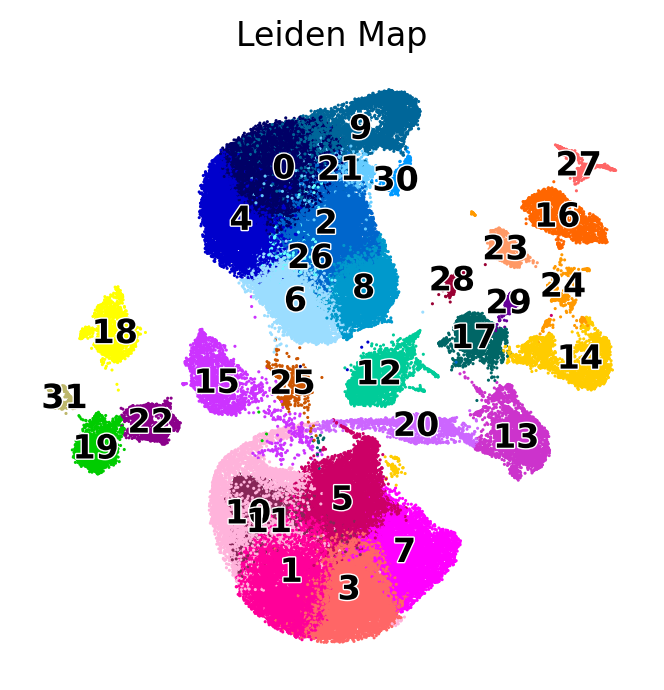

In [76]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['sys_leiden_1'], legend_fontsize =float(12) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color,legend_loc='on data', s=5,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, 
           title='Leiden Map', save=today+'_leiden_map_MMsysVI_all.pdf' )

In [77]:
cluster_color = {
    '0_Microglia': '#000066',
    '1_MOLs': '#ff0099',
    '2_Microglia': '#0066cc',
    '3_MOLs': '#ff6666',
    '4_Microglia': '#0000cc',
    '5_MOLs': '#cc0066',
    '6_Microglia': '#9bddff',
    '7_MOLs': '#ff00ff',
    '8_Microglia': '#0099cc',
    '9_Microglia': '#006699',
    '10_MOLs': '#ffb3db',
    '11_MOLs': '#872657',
    '12_BAMs': '#00cc99',
    '13_OPCs': '#cc33cc',
    '14_NPCs': '#ffcc00',
    '15_Choroid plexus': '#cc33ff',
    '16_Excitatory neurons': '#ff6600',
    '17_Astrocytes': '#006666',
    '18_Endothelial cells': '#ffff00',
    '19_Pericytes': '#00cc00',
    '20_COPs': '#cc66ff',
    '21_Microglia': '#66ccff',
    '22_VSMCs': '#d279a6',
    '23_Inhibitory neurons': '#ff9966',
    '24_Inhibitory neurons': '#ff9900',
    '25_Microglia/MOL mix': '#cc5500',
    '26_Microglia': '#66ffff',
    '27_Excitatory neurons': '#ff6666',
    '28_T cells': '#990033',
    '29_Ependymal cells': '#660099',
    '30_Microglia': '#0099ff',
    '31_VLMCs': '#bdb76b'
}

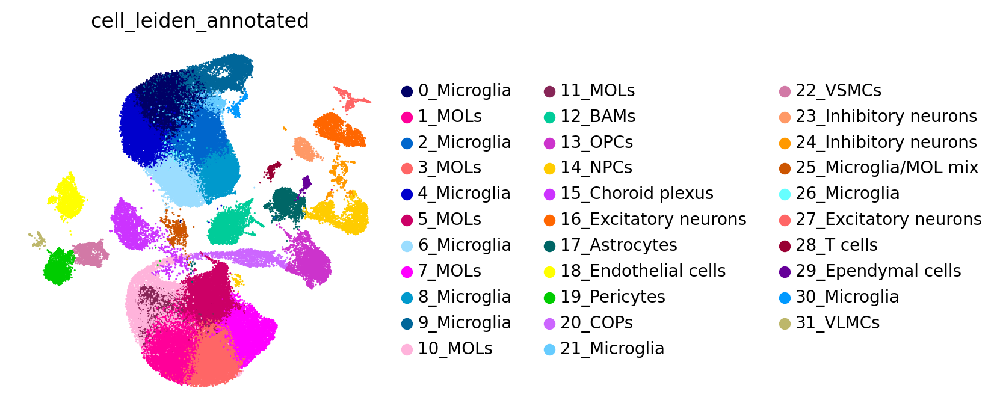

In [78]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cell_leiden_annotated'], legend_fontsize =float(10) , 
           wspace=0.6, cmap=mymap2,palette=cluster_color, s=5,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, save=today+'__leiden_map_MMsysVI_all_annotated.pdf' )

In [24]:
# Define the order of cell types
cell_type_order = [
    'OPCs', 'COPs', 'MOLs', 'Microglia + MOL mixed', 'Microglia', 'BAMs',
    'Astrocytes', 'Neuroblasts', 'Excitatory neurons', 'Inhibitory neurons',
    'Endothelial cells', 'Pericytes', 'Ependymal', 'VSMCs', 'VLMCs', 'Choroid plexus', 'T cells']

# Reorder the cell types
adata_all.obs['cluster_annotation'] = pd.Categorical(adata_all.obs['cluster_annotation'], categories=cell_type_order, ordered=True)

In [27]:
cluster_color = {
    'Microglia': '#0066cc',
    'MOLs': '#cc0066',
    'BAMs': '#00cc99',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia + MOL mixed': '#cc5500',
    'Neuroblasts': '#ffcc00',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffff00',
    'Pericytes': '#00cc00',
    'Choroid plexus': '#cc33ff',
    'Inhibitory neurons': '#ff9966',
    'Ependymal': '#660099',
    'T cells': '#990033',
    'VLMCs': '#bdb76b',
    'VSMCs': '#d279a6'
}

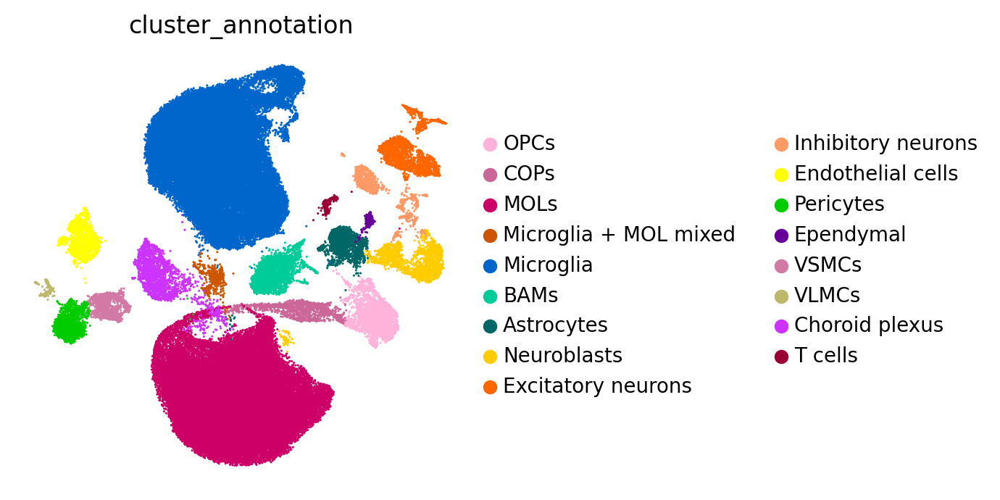

In [28]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cluster_annotation'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, s=5,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1) # save=today+'_annotated_cell_type.pdf' )

In [21]:
adata_all.write_h5ad('./mm_adata_all_annot_UPDATED.h5ad')
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

In [15]:
np.random.seed(0)
random_indices = np.random.permutation(list(range(adata_all.shape[0])))

In [16]:
cluster_color = {
    'Microglia': '#0066cc',
    'MOLs': '#cc0066',
    'BAMs': '#00cc99',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia + MOL mixed': '#cc5500',
    'Neuroblasts': '#ffcc00',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffff00',
    'Pericytes': '#00cc00',
    'Choroid plexus': '#cc33ff',
    'Inhibitory neurons': '#ff9966',
    'Ependymal': '#660099',
    'NKT/T cells': '#990033',
    'VLMCs': '#bdb76b',
    'VSMCs': '#d279a6'
}

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


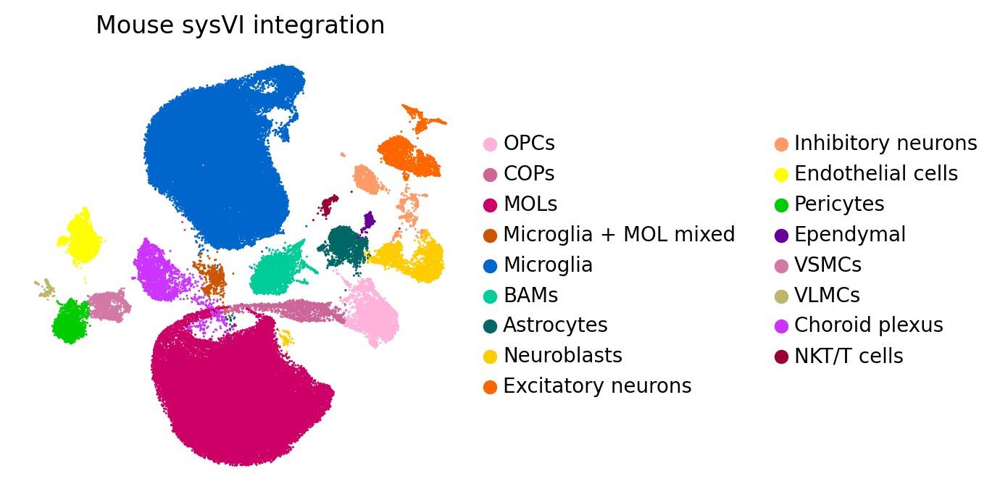

In [18]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all[random_indices, :], color=['cluster_annotation'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, s=5, title="Mouse sysVI integration",
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, save=today+'_annotated_cell_type_RANDOM.pdf' )

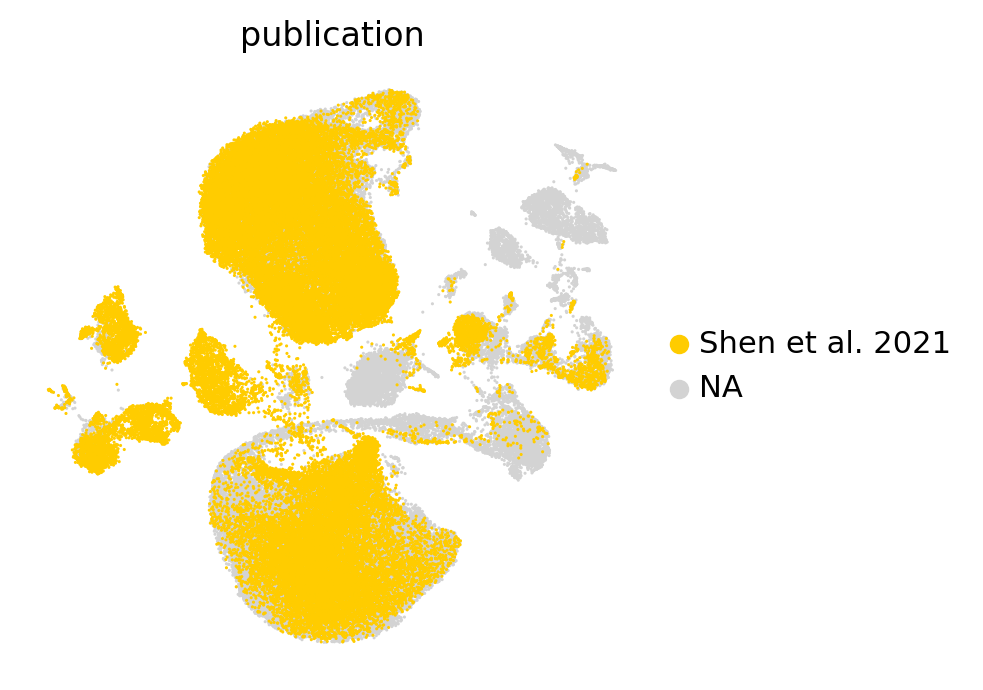

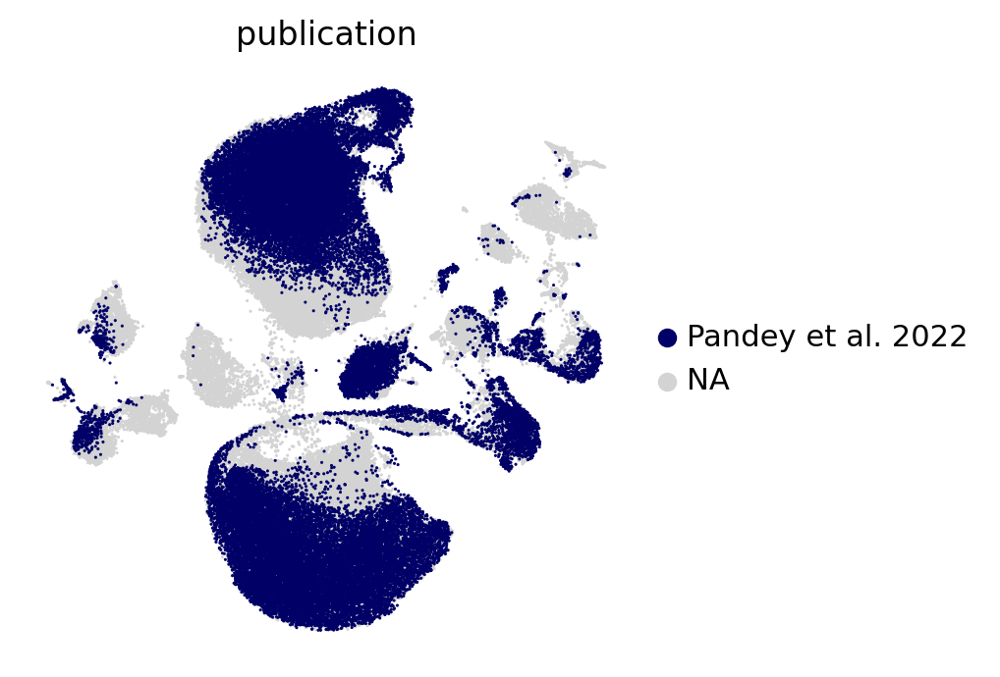

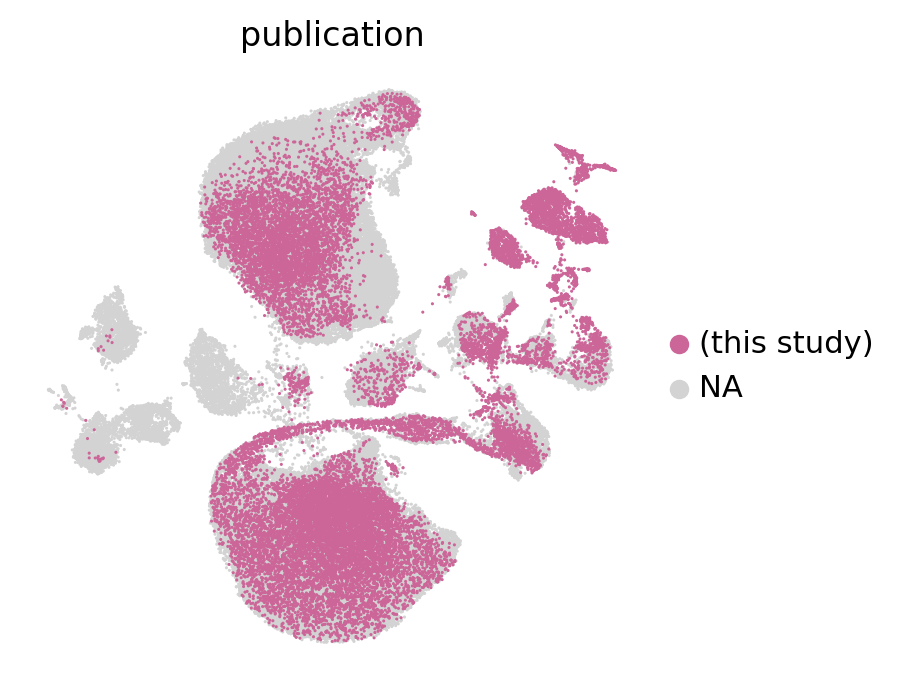

In [78]:
for i in set(adata_all.obs['publication']):
    sc.pl.umap(adata_all,color='publication',palette=con_cl,s=5, legend_fontweight= 'normal', frameon= False, groups=i,save=i+'publication.png')

# FILES TO SAVE

In [4]:
adata_all = sc.read_h5ad('./mm_adata_all_annot_UPDATED.h5ad')
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


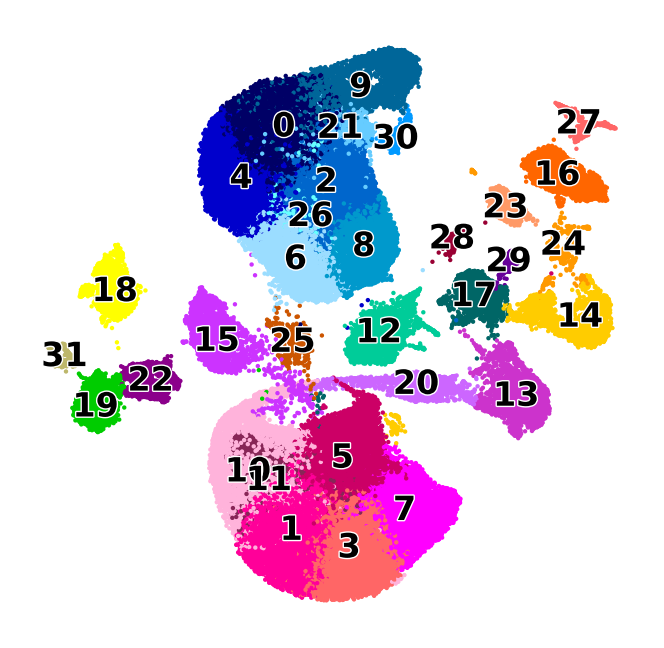

In [68]:
cluster_color = {
    '0': '#000066',  # Microglia
    '1': '#ff0099',  # MOL
    '2': '#0066cc',  # Microglia
    '3': '#ff6666',  # MOL
    '4': '#0000cc',  # Microglia
    '5': '#cc0066',  # MOL
    '6': '#9bddff',  # Microglia
    '7': '#ff00ff',  # MOL
    '8': '#0099cc',  # Microglia
    '9': '#006699',  # Microglia
    '10': '#ffb3db',  # MOL
    '11': '#872657',  # MOL
    '12': '#00cc99',  # BAM
    '13': '#cc33cc',  # OPCs
    '14': '#ffcc00',  # Neuroblasts
    '15': '#cc33ff',  # Choroid plexus
    '16': '#ff6600',  # Excitatory neurons
    '17': '#006666',  # Astrocytes
    '18': '#ffff00',  # Endothelial cells
    '19': '#00cc00',  # Pericytes
    '20': '#cc66ff',  # COPs
    '21': '#66ccff',  # Microglia
    '22': '#8b008b',  # VSMCs
    '23': '#ff9966',  # Inhibitory neurons
    '24': '#ff9900',  # Inhibitory neurons
    '25': '#cc5500',  # Microglia + MOL mixed
    '26': '#66ffff',  # Microglia
    '27': '#ff6666',  # Excitatory neurons
    '28': '#990033',  # NKT/T cells
    '29': '#660099',  # Ependymal
    '30': '#0099ff',  # Microglia
    '31': '#bdb76b'   # NA
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['sys_leiden_1'], s=10, legend_fontsize =float(12) , wspace=0.6, cmap=mymap2,
           palette=cluster_color,legend_loc='on data', legend_fontweight= 'bold', frameon= False , 
           legend_fontoutline=1, title='', save='_mm_sysVI_leiden1.png')

In [64]:
adata_all.obs['cell_leiden_annotated'].value_counts()

cell_leiden_annotated
0_Microglia                 13990
1_MOLs                      10538
2_Microglia                 10382
3_MOLs                       9880
4_Microglia                  9255
5_MOLs                       7345
6_Microglia                  5519
7_MOLs                       5176
8_Microglia                  4945
9_Microglia                  4351
10_MOLs                      4298
11_MOLs                      3903
12_BAMs                      2676
13_OPCs                      2624
14_Neuroblasts               2187
15_Choroid plexus            1853
16_Excitatory neurons        1640
17_Astrocytes                1639
18_Endothelial cells         1575
19_Pericytes                 1534
20_COPs                      1222
21_Microglia                 1221
22_VSMCs                      997
23_Inhibitory neurons         573
24_Inhibitory neurons         504
25_Microglia + MOL mixed      500
26_Microglia                  486
27_Excitatory neurons         429
28_NKT/T cells            

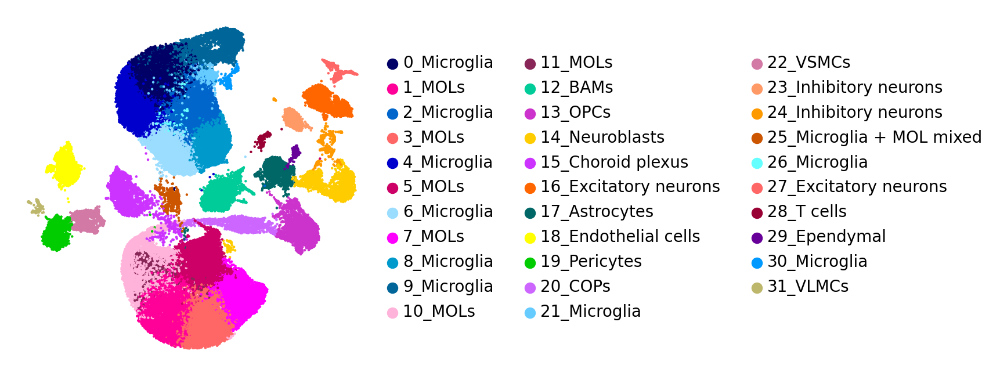

In [30]:
cluster_color = {
    '0_Microglia': '#000066',
    '1_MOLs': '#ff0099',
    '2_Microglia': '#0066cc',
    '3_MOLs': '#ff6666',
    '4_Microglia': '#0000cc',
    '5_MOLs': '#cc0066',
    '6_Microglia': '#9bddff',
    '7_MOLs': '#ff00ff',
    '8_Microglia': '#0099cc',
    '9_Microglia': '#006699',
    '10_MOLs': '#ffb3db',
    '11_MOLs': '#872657',
    '12_BAMs': '#00cc99',
    '13_OPCs': '#cc33cc',
    '14_Neuroblasts': '#ffcc00',
    '15_Choroid plexus': '#cc33ff',
    '16_Excitatory neurons': '#ff6600',
    '17_Astrocytes': '#006666',
    '18_Endothelial cells': '#ffff00',
    '19_Pericytes': '#00cc00',
    '20_COPs': '#cc66ff',
    '21_Microglia': '#66ccff',
    '22_VSMCs': '#d279a6',
    '23_Inhibitory neurons': '#ff9966',
    '24_Inhibitory neurons': '#ff9900',
    '25_Microglia + MOL mixed': '#cc5500',
    '26_Microglia': '#66ffff',
    '27_Excitatory neurons': '#ff6666',
    '28_T cells': '#990033',
    '29_Ependymal': '#660099',
    '30_Microglia': '#0099ff',
    '31_VLMCs': '#bdb76b'
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cell_leiden_annotated'], s=10, legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,
           palette=cluster_color,legend_fontweight= 'bold', frameon= False , legend_fontoutline=1,
           title='', save='_mm_sysVI_leiden_annotated.png')

 # Downsampling

In [278]:
#adata_all.write_h5ad('./mm_adata_all_annot_UPDATED.h5ad')

In [26]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['indiv_treatment_time'].unique()
for condition in unique_conditions:
    print(condition)

(this study)_LPC_7dpl
(this study)_Saline_Baseline
(this study)_Cuprizone_5 weeks
(this study)_Normal_Baseline
Pandey et al. 2022_LPC_5dpl
Pandey et al. 2022_LPC_28dpl
Pandey et al. 2022_No lesion_Baseline
Pandey et al. 2022_LPC_14dpl
Shen et al. 2021_Cuprizone_4+3 weeks
Shen et al. 2021_Cuprizone_4 weeks
Shen et al. 2021_Normal_Baseline


In [95]:
# Define the mapping dictionary for the remaining values in 'treatment_meta'
treatment_map = {
    '(this study)_LPC_7dpl': 'LPC_demyel',
    '(this study)_Saline_Baseline': 'LPC_baseline',
    '(this study)_Cuprizone_5 weeks': 'Cupr_demyel',
    '(this study)_Normal_Baseline': 'Cupr_baseline',
    'Pandey et al. 2022_LPC_5dpl': 'LPC_demyel',
    'Pandey et al. 2022_LPC_28dpl': 'LPC_remyel',
    'Pandey et al. 2022_No lesion_Baseline': 'LPC_baseline',
    'Pandey et al. 2022_LPC_14dpl': 'LPC_remyel_mid',
    'Shen et al. 2021_Cuprizone_4+3 weeks': 'Cupr_remyel',
    'Shen et al. 2021_Cuprizone_4 weeks': 'Cupr_demyel',
    'Shen et al. 2021_Normal_Baseline': 'Cupr_baseline',
    }

# Update the 'treatment_meta' column based on the mapping
adata_all.obs['lesion_status'] = adata_all.obs['indiv_treatment_time'].map(treatment_map)

In [96]:
adata_all.obs['lesion_status'].value_counts()

lesion_status
Cupr_demyel       23672
LPC_demyel        21398
Cupr_baseline     19825
LPC_baseline      15786
Cupr_remyel       13329
LPC_remyel        10082
LPC_remyel_mid     7925
Name: count, dtype: int64

In [42]:
mask = adata_all.obs['lesion_status'] != 'LPC_remyel_mid'
masked_adata = adata_all[mask]

In [43]:
masked_adata.obs['lesion_status'].value_counts()

lesion_status
Cupr_demyel      23672
LPC_demyel       21398
Cupr_baseline    19825
LPC_baseline     15786
Cupr_remyel      13329
LPC_remyel       10082
Name: count, dtype: int64

In [44]:
LPC_baseline = sc.pp.subsample(masked_adata[masked_adata.obs['lesion_status']=='LPC_baseline'],n_obs=10082,copy=True).obs_names
LPC_demyelination = sc.pp.subsample(masked_adata[masked_adata.obs['lesion_status']=='LPC_demyel'],n_obs=10082,copy=True).obs_names
cuprizone_baseline = sc.pp.subsample(masked_adata[masked_adata.obs['lesion_status']=='Cupr_baseline'],n_obs=10082,copy=True).obs_names
LPC_late_remyelination = sc.pp.subsample(masked_adata[masked_adata.obs['lesion_status']=='LPC_remyel'],n_obs=10082,copy=True).obs_names
cuprizone_demyelination = sc.pp.subsample(masked_adata[masked_adata.obs['lesion_status']=='Cupr_demyel'],n_obs=10082,copy=True).obs_names
cuprizone_remyelination = sc.pp.subsample(masked_adata[masked_adata.obs['lesion_status']=='Cupr_remyel'],n_obs=10082,copy=True).obs_names

adata_all_subsample = masked_adata[list(LPC_baseline)+ list(cuprizone_baseline) + list(LPC_demyelination)+list(LPC_late_remyelination)+list(cuprizone_demyelination)+list(cuprizone_remyelination)].copy()

In [45]:
adata_all_subsample.obs['lesion_status'].value_counts()

lesion_status
LPC_baseline     10082
Cupr_baseline    10082
LPC_demyel       10082
LPC_remyel       10082
Cupr_demyel      10082
Cupr_remyel      10082
Name: count, dtype: int64

In [46]:
# Define the order of cell types
cell_type_order = [
    'LPC_baseline', 'LPC_demyel', 'LPC_remyel', 'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']

# Reorder the cell types
adata_all_subsample.obs['lesion_status'] = pd.Categorical(adata_all_subsample.obs['lesion_status'], 
                                                     categories=cell_type_order, ordered=True)

In [47]:
adata_all_subsample.obs['lesion_status'].value_counts()

lesion_status
LPC_baseline     10082
LPC_demyel       10082
LPC_remyel       10082
Cupr_baseline    10082
Cupr_demyel      10082
Cupr_remyel      10082
Name: count, dtype: int64

In [48]:
sc.tl.embedding_density(adata_all_subsample, basis='umap', groupby='lesion_status')

computing density on 'umap'
--> added
    'umap_density_lesion_status', densities (adata.obs)
    'umap_density_lesion_status_params', parameter (adata.uns)


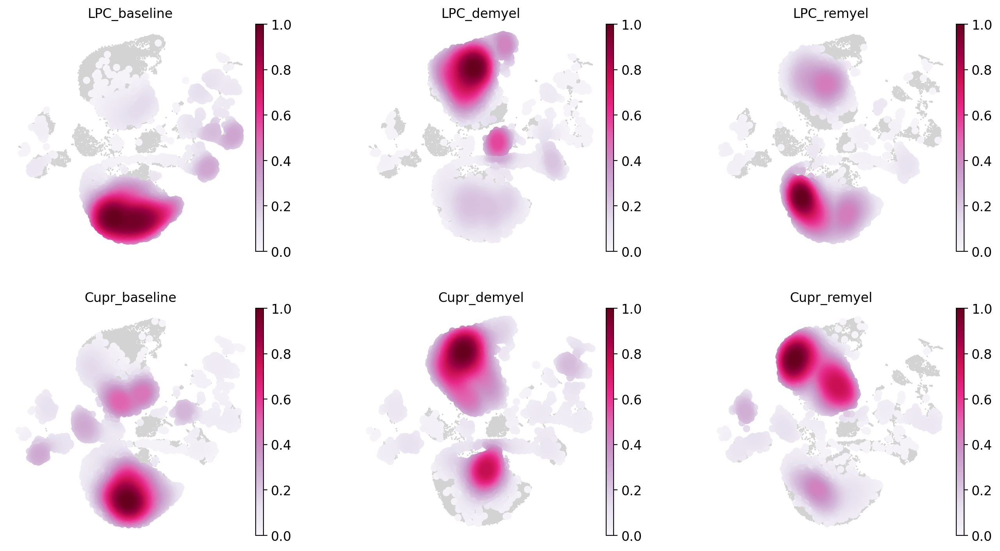

In [49]:
sc.pl.embedding_density(adata_all_subsample, basis='umap',  key='umap_density_lesion_status', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, 
                        ncols=3, save=today+'_distribution_downscaling_all.png')

In [50]:
np.random.seed(0)
random_indices = np.random.permutation(list(range(adata_all_subsample.shape[0])))

# Gene scoring

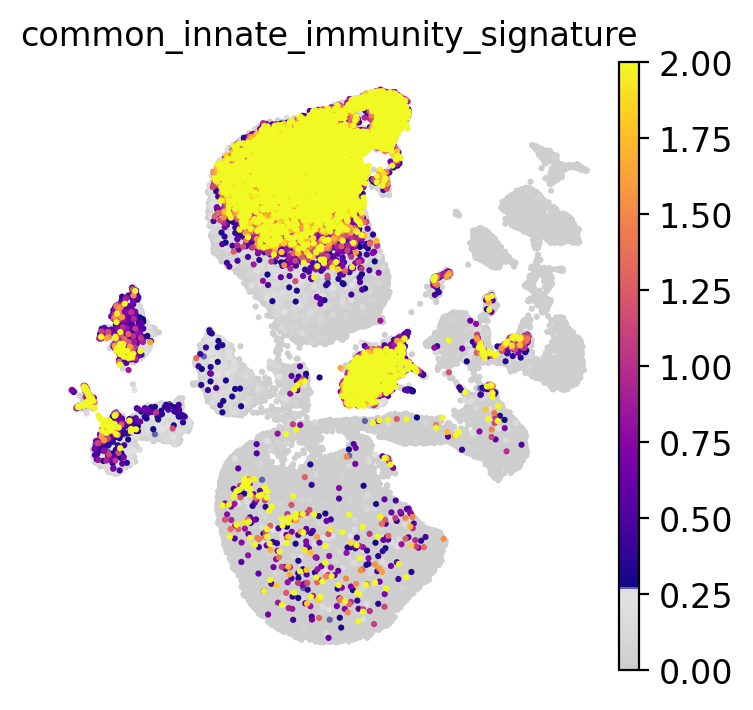

In [7]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['common_innate_immunity_signature'],legend_fontsize =float(12), \
           cmap=mymap2, vmin=0, vmax=2, 
           legend_fontweight= 'normal', frameon= False, s=20, save='_mm_innate_immunity_plot.png')

/tmp/1218422.1.gpu/ipykernel_1494265/824715868.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df.groupby(['lesion_status', 'cluster_annotation'])['gene_score'].mean().unstack()


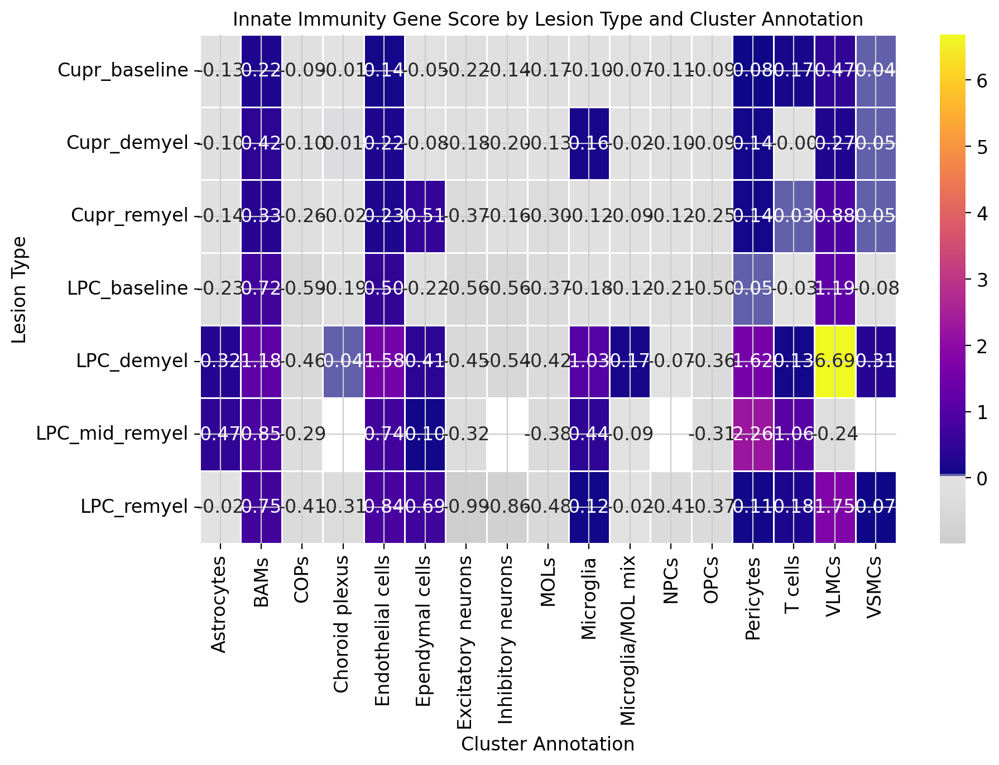

In [8]:
# Create a dataframe with the relevant columns
df = adata_all.obs[['lesion_status', 'cluster_annotation']].copy()
df['gene_score'] = adata_all.obs['common_innate_immunity_signature']

# Compute the mean gene score for each (lesion_type, cluster_annotation) combination
heatmap_data = df.groupby(['lesion_status', 'cluster_annotation'])['gene_score'].mean().unstack()

# Plot the heatmap
plt.figure(figsize=(10, 6))
sb.heatmap(heatmap_data, cmap=mymap2, annot=True, fmt=".2f", linewidths=0.5)

# Formatting
plt.xlabel("Cluster Annotation")
plt.ylabel("Lesion Type")
plt.title("Innate Immunity Gene Score by Lesion Type and Cluster Annotation")

plt.show()

In [10]:
cupr_genes = ['Syt4', 'Nupr1', 'Tenm4', 'Trib3', 'Moxd1', 'Gdf15', 'Slc7a5', 'Cyb5r2', 'Sox2',
              'Dnal4', 'Smpd3', 'Ddit3', 'Atf4', 'Eda2r', 'Cox20', 'Cebpg', 'Cdh6',
              'Chchd10', 'Frmd4a', 'Cd44', 'Vegfa', 'Xylt1', 'Ptch1', 'Smn1']

sc.tl.score_genes(adata_all, cupr_genes, score_name='Cupr_signature')

computing score 'Cupr_signature'
    finished: added
    'Cupr_signature', score of gene set (adata.obs).
    650 total control genes are used. (0:00:11)


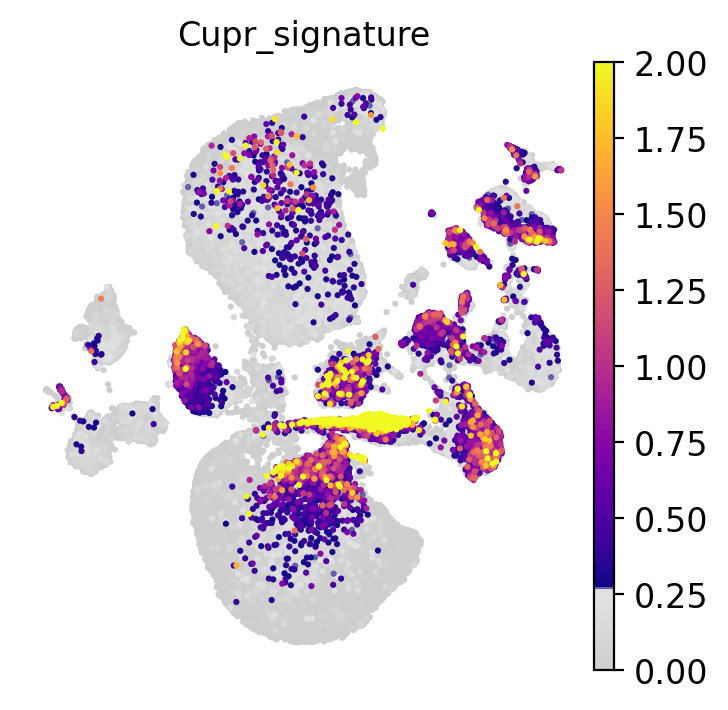

In [11]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['Cupr_signature'],legend_fontsize =float(12),
           cmap=mymap2, vmin=0, vmax=2, legend_fontweight= 'normal', frameon= False, s=20,
           save='_h2m_Cupr_DA_sig.png')

In [12]:
lpc_genes = ['Klk8', 'Bcan', 'Steap3', 'Sox5', 'Nrcam', 'Plvap', 'Chl1', 'Nav3',  
            'Fgfrl1', 'Sema4f', 'Tspan4', 'Amotl1', 'Ifit1', 'Oasl2', 'Piezo2', 'Anxa2',  
            'Socs3', 'Gbp3', 'Mmd2', 'Usp18', 'Npb', 'Fam124a', 'Ddx60', 'Bcl3',  
            'Ralgps2', 'Pdzrn4', 'Apba2', 'Ifi27l2a', 'C4b', 'Nnat', 'Snx10', 'Rasip1',  
            'Cachd1', 'Masp1', 'Parp3', 'Kcnip1', 'Pros1']

sc.tl.score_genes(adata_all, lpc_genes, score_name='LPC_signature')

computing score 'LPC_signature'
    finished: added
    'LPC_signature', score of gene set (adata.obs).
    699 total control genes are used. (0:00:10)


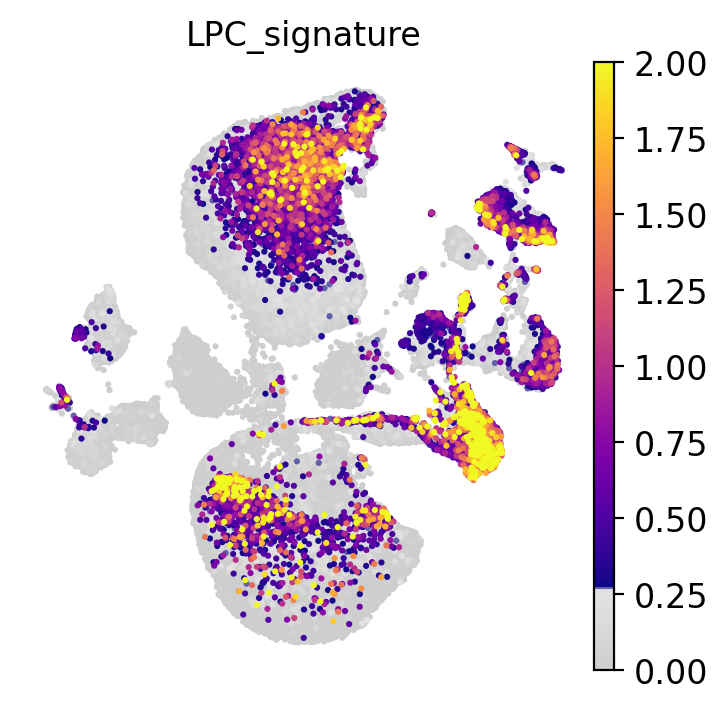

In [13]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['LPC_signature'],legend_fontsize =float(12),
           cmap=mymap2, vmin=0, vmax=2, legend_fontweight= 'normal', frameon= False, s=20,
           save='_h2m_LPC_DA_sig.png')

# My figures code

In [4]:
adata_all = sc.read_h5ad('./mm_adata_all_annot_UPDATED.h5ad')

In [21]:
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha

In [22]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['cluster_annotation'].unique()
for condition in unique_conditions:
    print(condition)

Excitatory neurons
Inhibitory neurons
MOLs
OPCs
COPs
Microglia
Microglia + MOL mixed
Neuroblasts
Astrocytes
BAMs
Ependymal
Endothelial cells
T cells
Pericytes
Choroid plexus
VLMCs
VSMCs


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:175: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_tidy.mask(~obs_bool).groupby(level=0).mean().fillna(0)
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided 

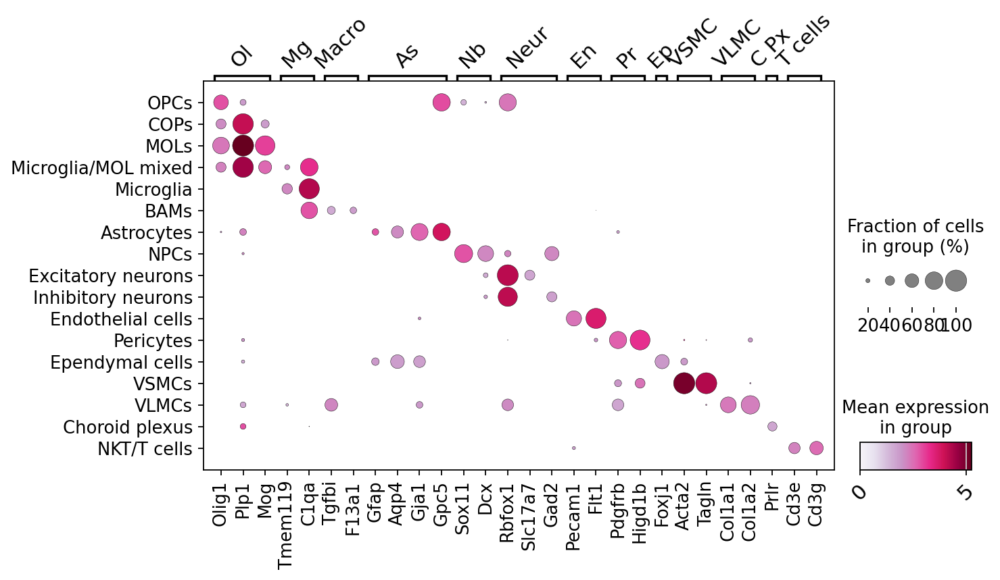

In [75]:
marker_genes = {
    'Ol': ['Olig1', 'Plp1', 'Mog'],
    'Mg': ['Tmem119', 'C1qa'],
    'Macro': ['Tgfbi', 'F13a1'],
    'As': ['Gfap', 'Aqp4','Gja1', 'Gpc5'],
    'Nb': ['Sox11', 'Dcx'],
    'Neur': ['Rbfox1', 'Slc17a7', 'Gad2'],
    'En': ['Pecam1', 'Flt1'],
    'Pr': ['Pdgfrb', 'Higd1b'],
    'Ep': ['Foxj1'],
    'VSMC': ['Acta2', 'Tagln'],
    'VLMC':['Col1a1', 'Col1a2'],
    'C Px': ['Prlr'],
    'T cells': ['Cd3e','Cd3g'],
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes = [gene for genes in marker_genes.values() for gene in genes]

# Correct var_group_positions based on marker_genes
var_group_positions = []
start = 0
for genes in marker_genes.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions.append((start, end))  # Add the start and end index to var_group_positions
    start = end + 1  # Update the start index for the next group

# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
        adata_all,
        groupby="cluster_annotation",
        var_names=all_genes,
        use_raw=False,
        log=False,
        dendrogram=False,
        layer='log1p_norm',
        var_group_positions=var_group_positions,
        var_group_labels=list(marker_genes.keys()),
        var_group_rotation=45,
        swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
        cmap='PuRd',  # Choose a color map for dot intensities
        color_map='PuRd',  # Choose a color map for dot colors
        figsize=(10, 8),  # Set the figure size
        show=False,
        dot_min=0.1,
        mean_only_expressed=True,
        expression_cutoff=1,
    )

# Get the current Axes instance
ax = plt.gca()

# Set the font size and rotation angle for the x-axis (gene labels)
plt.setp(ax.get_xticklabels(), fontsize=14, rotation=45)

# Adjust spacing between y-axis ticks
plt.subplots_adjust(left=0.25)  # Adjust left margin to reduce space between y-axis ticks and the plot
#plt.subplots_adjust(bottom=0.5) 
plt.subplots_adjust(top=0.6) 

# Alternatively, for vector graphics format
plt.savefig('./figures/dot_plot_cell_types_mm_ALL.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:175: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_tidy.mask(~obs_bool).groupby(level=0).mean().fillna(0)
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided 

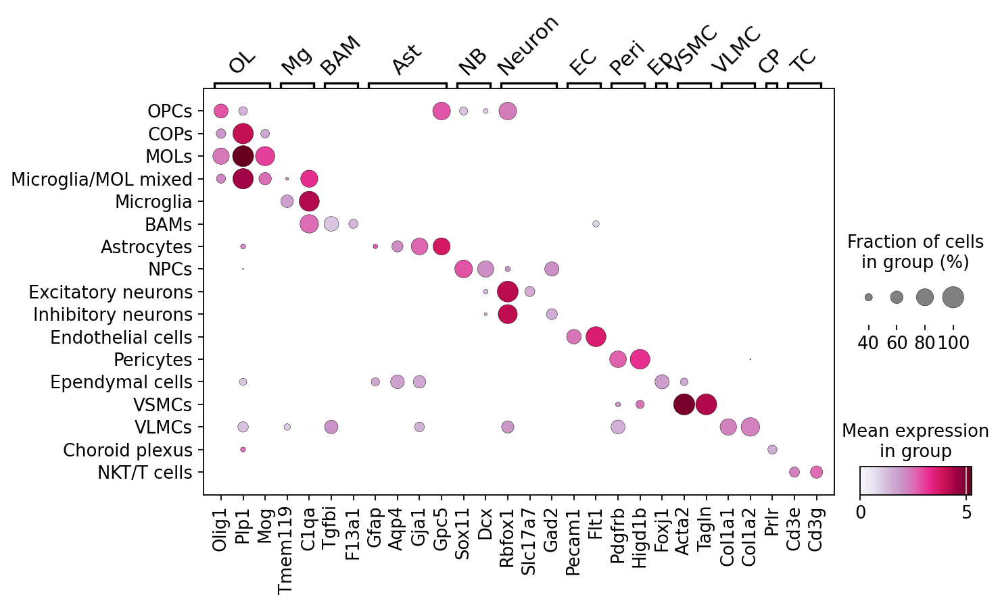

In [82]:
marker_genes = {
    'OL': ['Olig1', 'Plp1', 'Mog'],
    'Mg': ['Tmem119', 'C1qa'],
    'BAM': ['Tgfbi', 'F13a1'],
    'Ast': ['Gfap', 'Aqp4','Gja1', 'Gpc5'],
    'NB': ['Sox11', 'Dcx'],
    'Neuron': ['Rbfox1', 'Slc17a7', 'Gad2'],
    'EC': ['Pecam1', 'Flt1'],
    'Peri': ['Pdgfrb', 'Higd1b'],
    'Ep': ['Foxj1'],
    'VSMC': ['Acta2', 'Tagln'],
    'VLMC':['Col1a1', 'Col1a2'],
    'CP': ['Prlr'],
    'TC': ['Cd3e','Cd3g'],
}

# Define the order of cell types
#cell_type_order = [
#    'OPCs', 'COPs', 'MOL', 'Microglia + MOL mixed', 'Microglia', 'BAM',
#    'Astrocytes', 'Neuroblasts', 'Excitatory neurons', 'Inhibitory neurons',
#    'Endothelial cells', 'Pericytes', 'Ependymal', 'VSMCs', 'VLMCs', 'Choroid plexus', 'NKT/T cells']

# Reorder the cell types
#adata_all.obs['cluster_annotation'] = pd.Categorical(adata_all.obs['cluster_annotation'], 
#                                                     categories=cell_type_order, ordered=True)

# Flatten the list of genes in marker_genes while maintaining order
all_genes = [gene for genes in marker_genes.values() for gene in genes]

# Correct var_group_positions based on marker_genes
var_group_positions = []
start = 0
for genes in marker_genes.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions.append((start, end))  # Add the start and end index to var_group_positions
    start = end + 1  # Update the start index for the next group

# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
        adata_all,
        groupby="cluster_annotation",
        var_names=all_genes,
        use_raw=False,
        log=False,
        dendrogram=False,
        layer='log1p_norm',
        var_group_positions=var_group_positions,
        var_group_labels=list(marker_genes.keys()),
        var_group_rotation=45,
        swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
        cmap='PuRd',  # Choose a color map for dot intensities
        color_map='PuRd',  # Choose a color map for dot colors
        figsize=(10, 8),  # Set the figure size
        show=False,
        dot_min=0.2,  # Adjust the minimum dot size
        dot_max=1,  # Adjust the maximum dot size
        mean_only_expressed=True,
        #expression_cutoff=1,
    )

# Get the current Axes instance
ax = plt.gca()

# Set the font size and rotation angle for the x-axis (gene labels)
#plt.setp(ax.get_xticklabels(), fontsize=24, rotation=45)

# Set the font size for the y-axis (cell type labels)
ax.set_ylabel(ax.get_ylabel(), fontsize=24)

# Set the font size for the x-axis (gene labels)
ax.set_xlabel(ax.get_xlabel(), fontsize=24)

# Adjust spacing between y-axis ticks
plt.subplots_adjust(left=0.25)  # Adjust left margin to reduce space between y-axis ticks and the plot
#plt.subplots_adjust(bottom=0.5) 
plt.subplots_adjust(top=0.62) 

# Alternatively, for vector graphics format
plt.savefig('./figures/dot_plot_cell_types_mm_ALL2.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

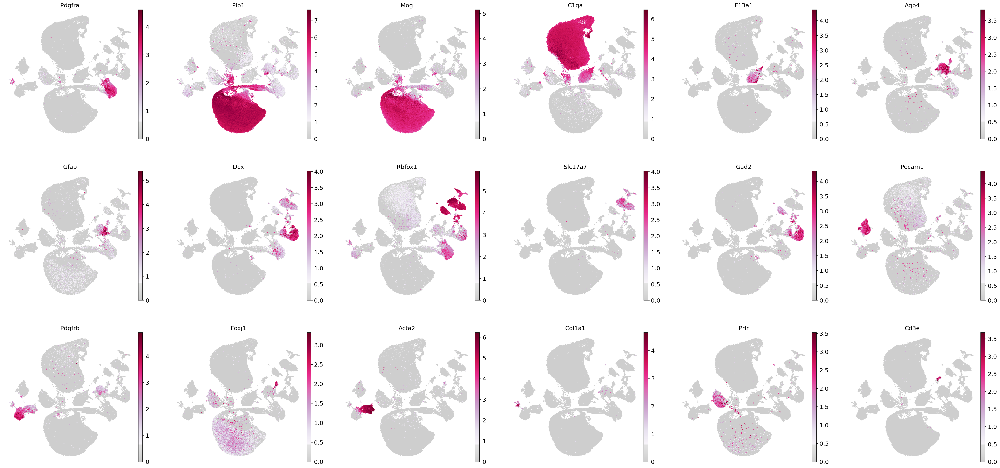

In [84]:
# Define a nice color map for gene expression
colors2 = plt.cm.PuRd(np.linspace(0, 1, 128))  # Use PuRd color map for deep red/purple color
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))  # Greys for low values
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

marker_genes = {
    'Oligo': ['Olig1', 'Plp1', 'Mog'],
    'Microglia': ['Tmem119', 'C1qa'],
    'Macrophage': ['Tgfbi', 'F13a1'],
    'Astro': ['Gfap', 'Aqp4','Gja1', 'Gpc5'],
    'Neuroblast': ['Sox11', 'Dcx'],
    'Neuron': ['Rbfox1', 'Slc17a7', 'Gad2'],
    'Endothelial': ['Pecam1', 'Flt1'],
    'Pericytes': ['Pdgfrb', 'Higd1b'],
    'Epednymal': ['Foxj1'],
    'VSMCs': ['Acta2', 'Tagln'],
    'VLMCs':['Col1a1', 'Col1a2'],
    'Chor. plx': ['Prlr'],
    'T cell': ['Cd3e','Cd3g'],
}

sc.pl.embedding(
    adata_all,
    basis='X_umap',
    color=['Pdgfra', 'Plp1', 'Mog', 'C1qa', 'F13a1', 'Aqp4', 'Gfap', 
           'Dcx', 'Rbfox1', 'Slc17a7', 'Gad2', 'Pecam1','Pdgfrb',
           'Foxj1','Acta2', 'Col1a1', 'Prlr', 'Cd3e'],
    frameon=False,
    ncols=6,
    layer='log1p_norm',
    color_map=mymap,
    size=20,
    legend_fontsize = 'xx-large',
    legend_loc='on data',
    save='_cell_type_markers2.png'
)

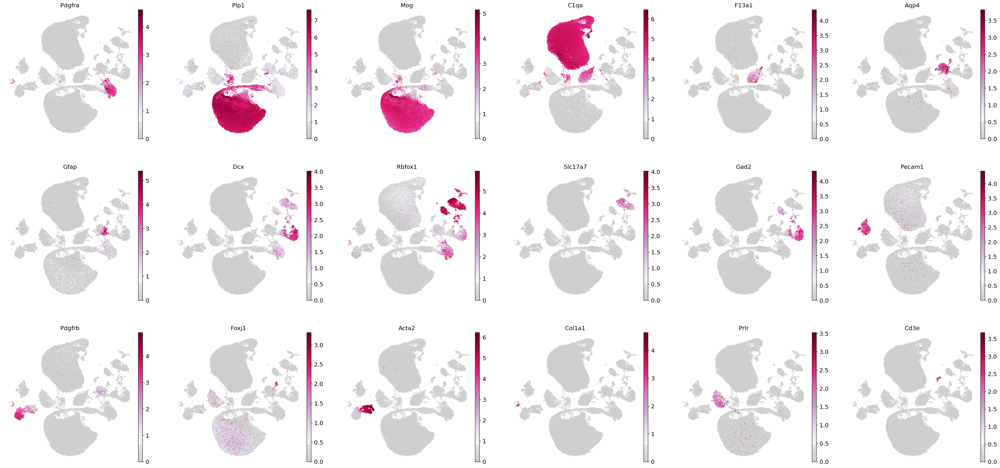

In [87]:
sc.pl.embedding(
    adata_all,
    basis='X_umap',
    color=['Pdgfra', 'Plp1', 'Mog', 'C1qa', 'F13a1', 'Aqp4', 'Gfap', 
           'Dcx', 'Rbfox1', 'Slc17a7', 'Gad2', 'Pecam1','Pdgfrb',
           'Foxj1','Acta2', 'Col1a1', 'Prlr', 'Cd3e'],
    frameon=False,
    ncols=6,
    layer='log1p_norm',
    color_map=mymap,
    size=10,
    legend_fontsize = 'xx-large',
    save='_cell_type_markers3.png'
)

In [19]:
Markers_all_cells ={'Microglia': ['Tmem119', 'Cx3cr1', 'P2ry12', 'P2ry13', 'Gpr34', 'Olfml3', 'Selplg', 'Sparc', 'Fcrls', 'Siglech', 'Slc2a5','Mafb', 'Pmepa1', 'Cd14'],
                   'DAM':['Lpl','Cst7'], 
                   'Macrophages':['Itga4', 'Tgfbi', 'Ifitm2', 'Ifitm3', 'Tagln2','F13a1', 'Kynu', 'S100a11', 'S100a6'],
                   'BAM': [ 'Cd163', 'Mrc1','Lyve1', 'Siglec1'],
                   'Monocytes':['Ly6c2','Ccr2','Spn'],
                   'DCs':['Cd24a','Itgax','Bst2','Cd209a','Xcr1','Ccr7','Ccr9', 'Flt3','Itgae', 'Itgam','H2-Oa','Tnni2','Kctd14','Kmo','Hepacam2'], 
                   'NKT cells':['Cd3e','Klrb1c','Ncr1'],
                    'Neuroblasts':['Sox11', 'Dcx'],
                   'T cells':['Cd3d','Cd3e','Cd3g','Lat','Bcl11b'],
                   'B cells':['Cd19', 'Ms4a1', 'Sdc1', 'Pax5', 'Ms4a1'],
                   'Neutrophils': ['S100a9'],
                    'Ependymal': ['Foxj1', 'Rabl2'],
                   'Neurons':['Rbfox1', 'Rbfox3','Slc17a7','Gabra1', 'Tubb3', 'Cux1','Pou3f2','Bcl11b', 'Foxp2'],
                   'OPCs':['Pdgfra', 'C1ql1'],
                   'COPs':['Neu4', 'Brca1'],
                   'MOL':['Opalin', 'Ninj2'],
                   'Astrocytes':['Sox9', 'Gfap','Aldh1l1','Atp1b2', 'Vim','Gfap','Slc1a3','Aldoc'],
                   'Pericytes':['Pdgfrb', 'Higd1b','Ndufa4l2','Rgs5','Kcnj8'],
                   'VSMCs':['Acta2', 'Tagln','Myh11', 'Mustn1','Map3k7cl'],
                   'VLMCs':['Mgp', 'Slc47a1',  'Thbd', 'Col1a1', 'Col1a2'],
                   'Endothelial': ['Pecam1', 'Flt1', 'Ly6c1','Cldn5', 'Ly6a','Pltp','Pglyrp1', 'Scgb3a1'],
                    'Choroid plexus': ['Prlr']
                  }#Ochocka et al., 2021, van Hove et al., 2016, Zeisel et al. 2018

In [20]:
for names in list(Markers_all_cells):
    sc.tl.score_genes(adata_all, Markers_all_cells[names], score_name=names )

computing score 'Microglia'
    finished: added
    'Microglia', score of gene set (adata.obs).
    200 total control genes are used. (0:00:02)
computing score 'DAM'
    finished: added
    'DAM', score of gene set (adata.obs).
    50 total control genes are used. (0:00:02)
computing score 'Macrophages'
    finished: added
    'Macrophages', score of gene set (adata.obs).
    399 total control genes are used. (0:00:02)
computing score 'BAM'
    finished: added
    'BAM', score of gene set (adata.obs).
    200 total control genes are used. (0:00:01)
computing score 'Monocytes'
    finished: added
    'Monocytes', score of gene set (adata.obs).
    150 total control genes are used. (0:00:01)
computing score 'DCs'
    finished: added
    'DCs', score of gene set (adata.obs).
    500 total control genes are used. (0:00:02)
computing score 'NKT cells'
    finished: added
    'NKT cells', score of gene set (adata.obs).
    149 total control genes are used. (0:00:01)
computing score 'Neurobla

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

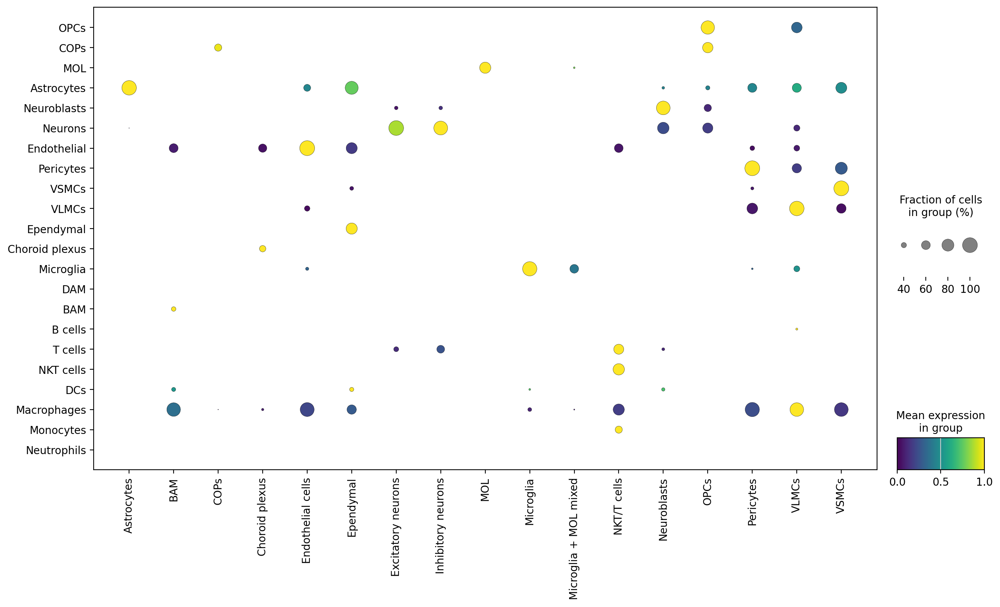

In [22]:
sc.pl.dotplot(adata_all, ['OPCs','COPs', 'MOL', 'Astrocytes', 'Neuroblasts', 'Neurons','Endothelial','Pericytes', 
                          'VSMCs', 'VLMCs', 'Ependymal', 'Choroid plexus',  'Microglia', 'DAM', 'BAM', 'B cells', 'T cells', 'NKT cells', 
                          'DCs','Macrophages', 'Monocytes', 'Neutrophils'], 'cluster_annotation',  
              standard_scale='var', swap_axes=True, figsize=(15,8),
              var_group_rotation=90, dendrogram=False, dot_min=0.2, cmap='viridis')
# save='markers_3dpi.png')

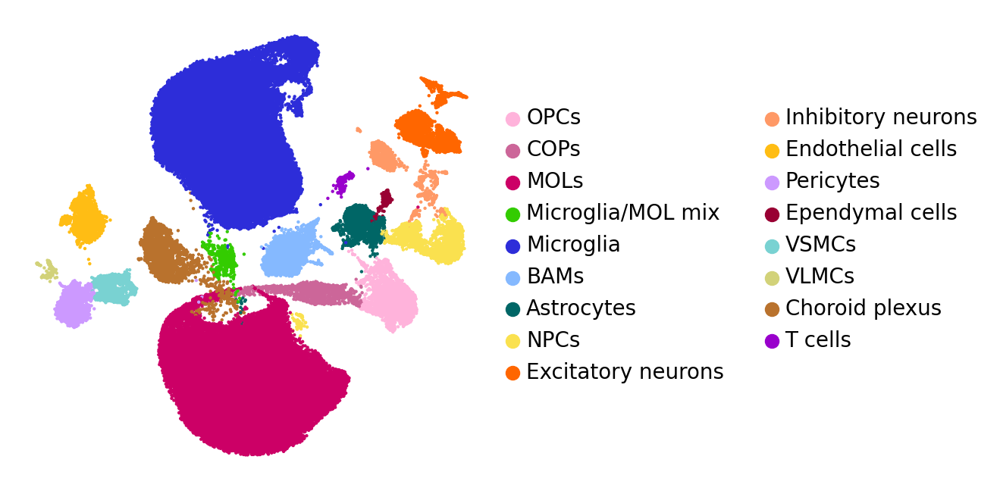

In [45]:
cluster_color = {
    'Microglia': '#2d2dd9',
    'MOLs': '#cc0066',
    'BAMs': '#85b9ff',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia/MOL mix': '#33cc00',
    'NPCs': '#fae14f',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffbd14',
    'Pericytes': '#cc99ff',
    'Choroid plexus': '#b9722d',
    'Inhibitory neurons': '#ff9966',
    'Ependymal cells': '#990033',
    'T cells': '#9900cc',
    'VLMCs': '#d2d279',
    'VSMCs': '#79d2d2'
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cluster_annotation'], s=10, legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,
           palette=cluster_color,legend_fontweight= 'bold', frameon= False , legend_fontoutline=1,
           title='', save='_mm_sysVI_NEW_BAM.png')

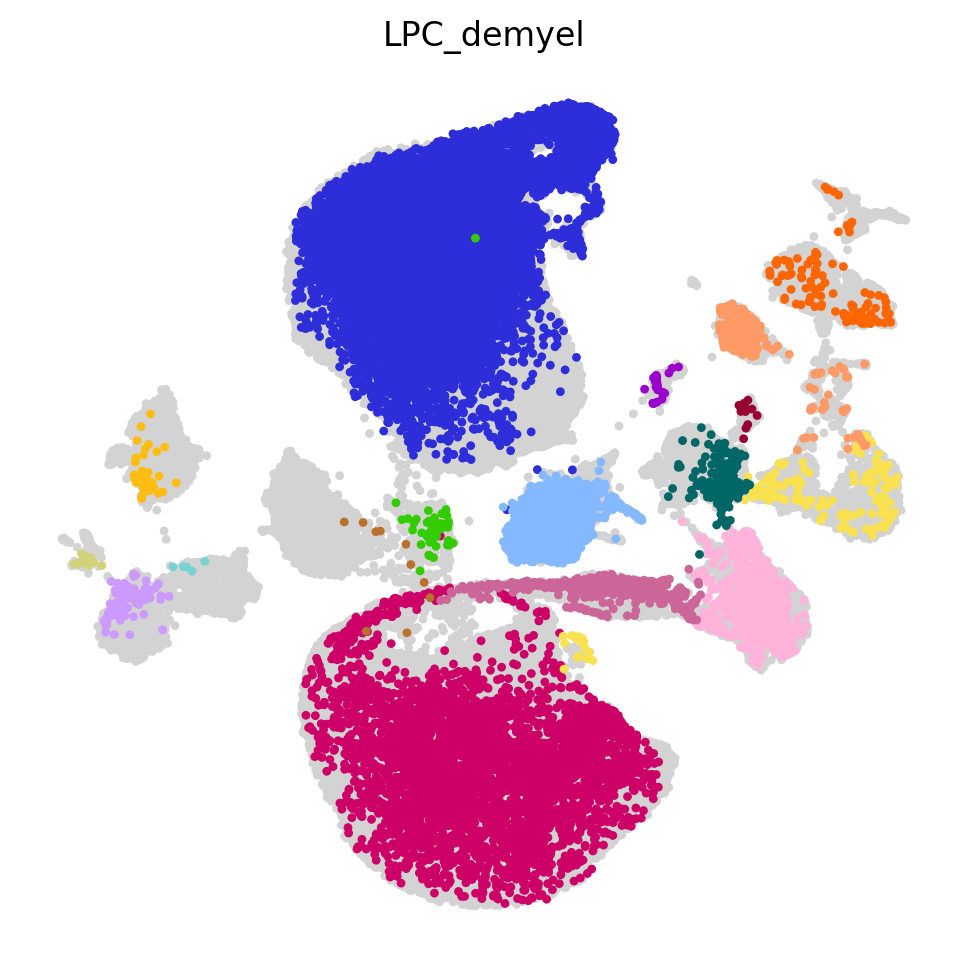

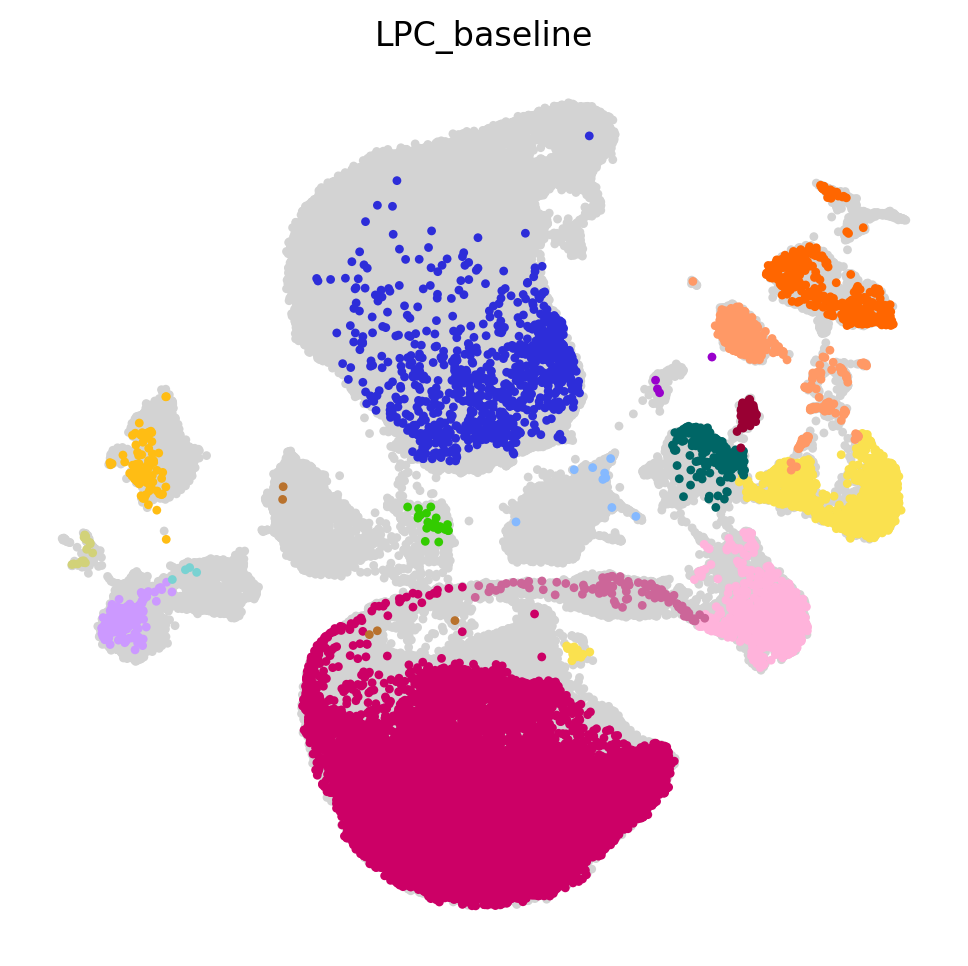

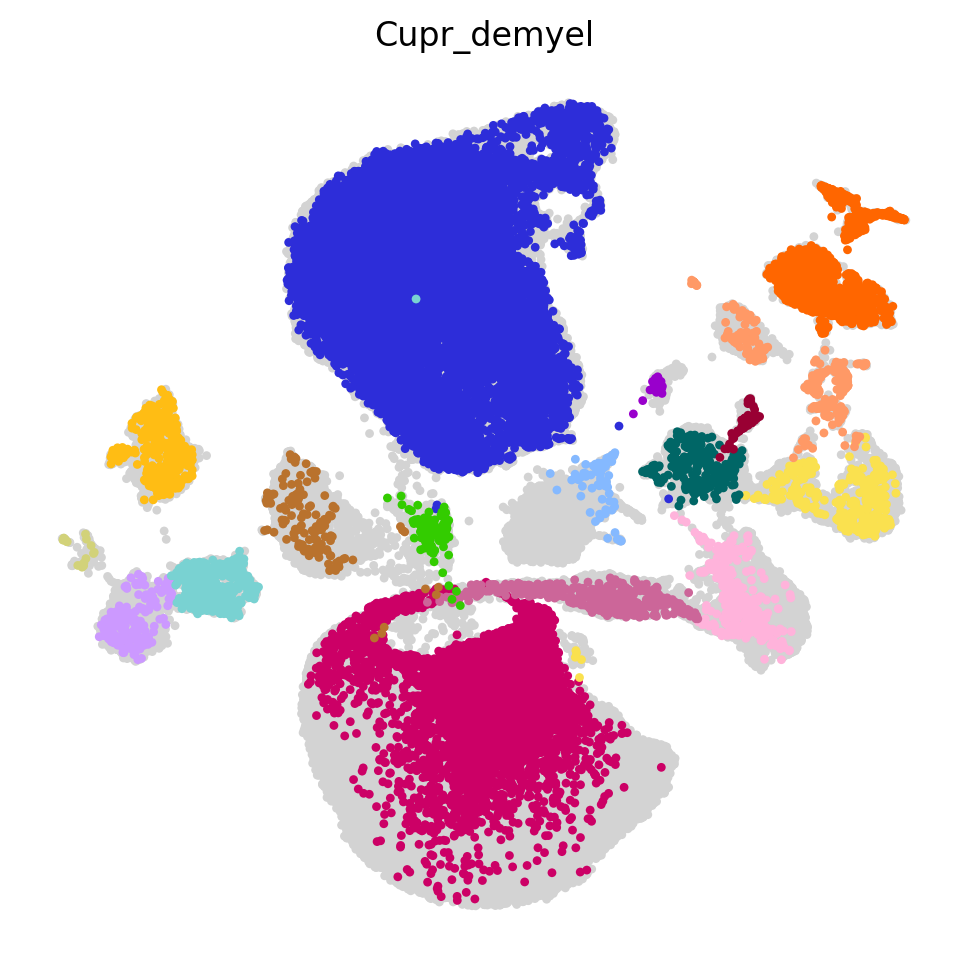

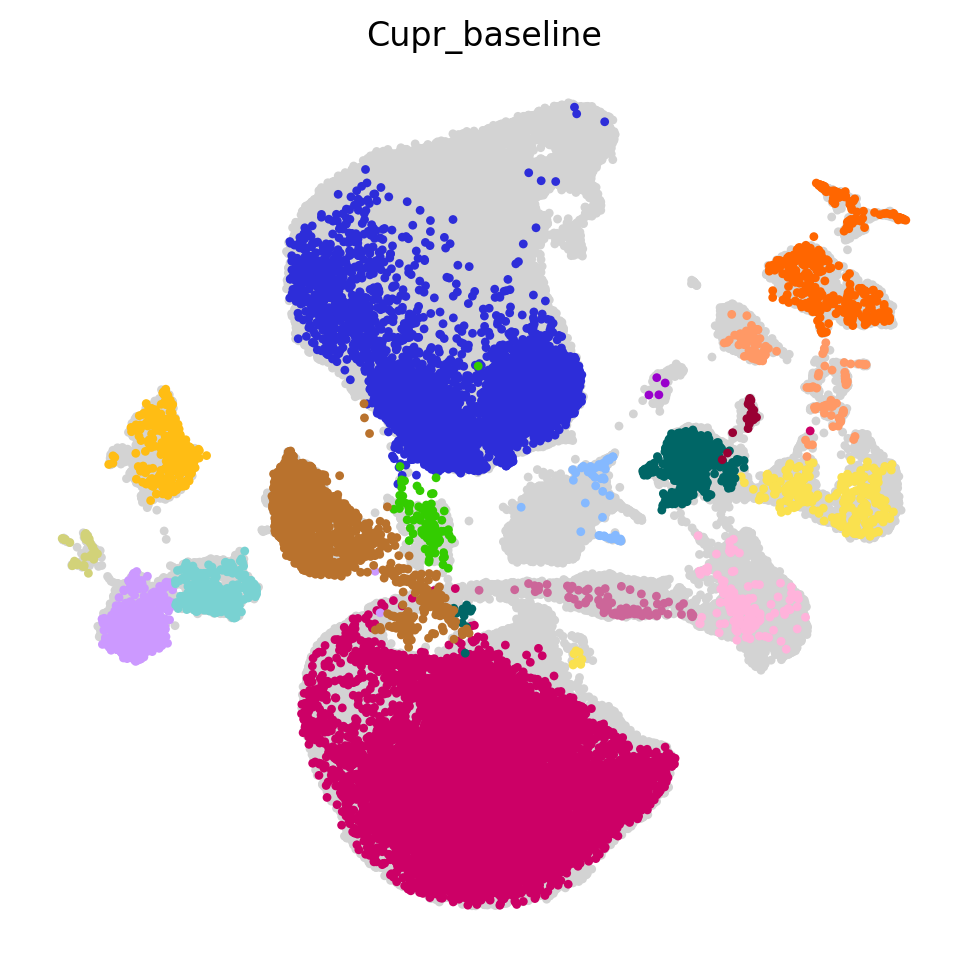

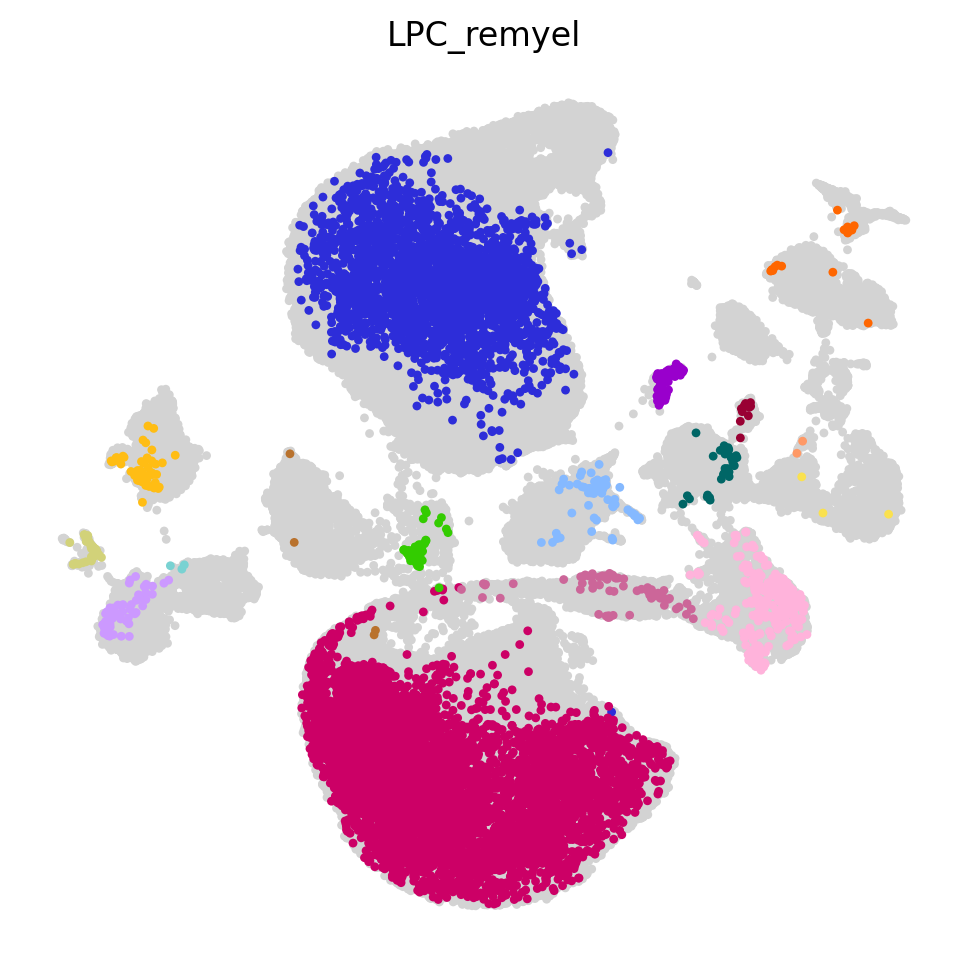

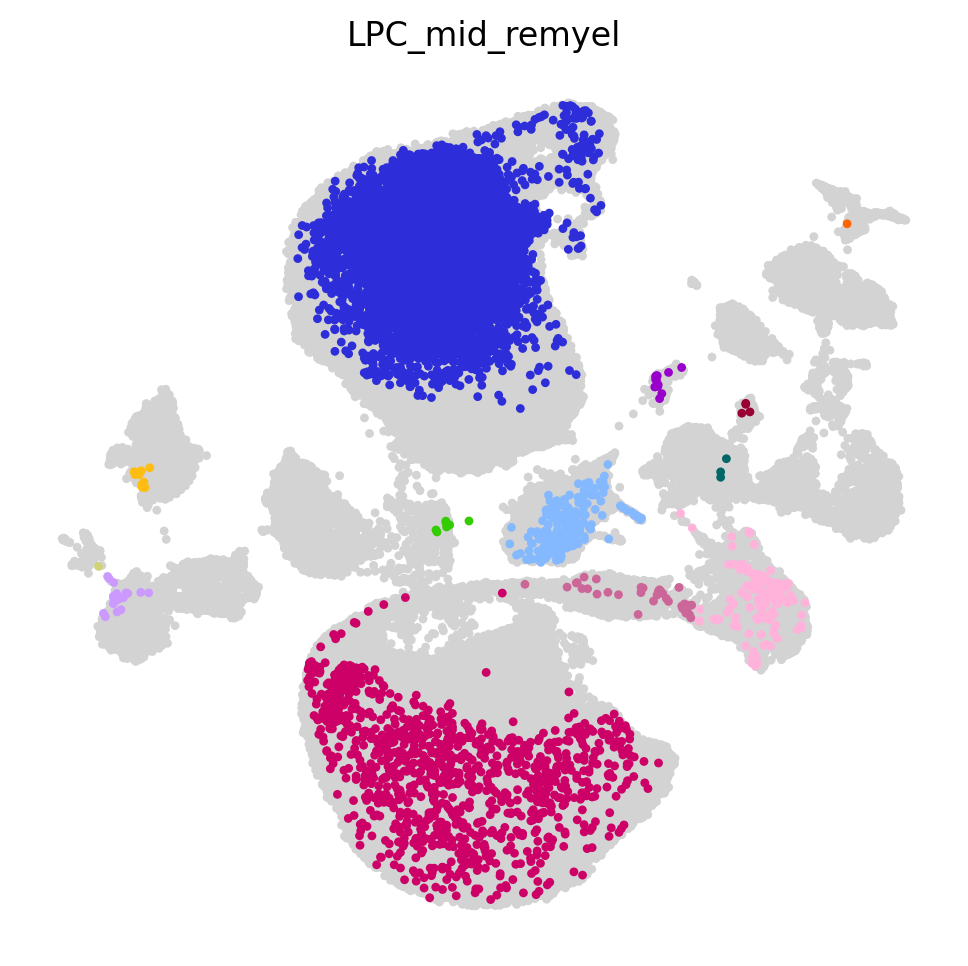

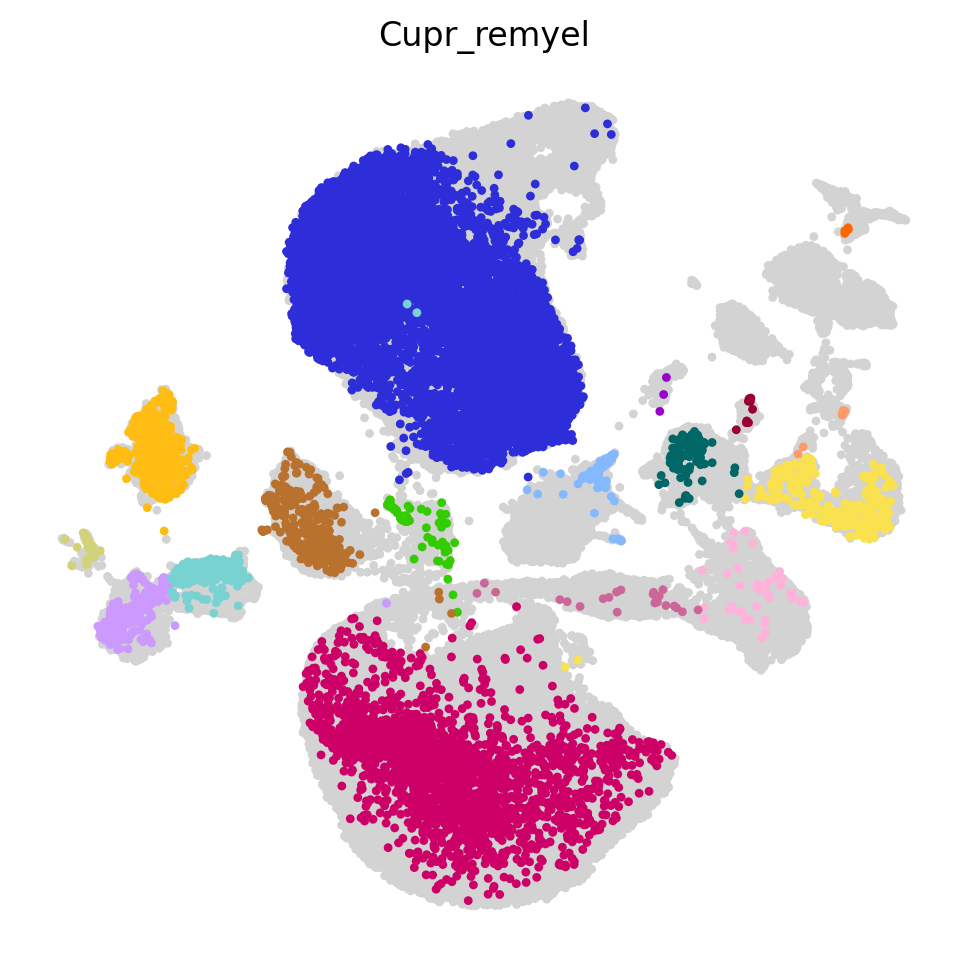

In [36]:
cluster_color = {
    'Microglia': '#2d2dd9',
    'MOLs': '#cc0066',
    'BAMs': '#85b9ff',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia/MOL mix': '#33cc00',
    'NPCs': '#fae14f',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffbd14',
    'Pericytes': '#cc99ff',
    'Choroid plexus': '#b9722d',
    'Inhibitory neurons': '#ff9966',
    'Ependymal cells': '#990033',
    'NKT/T cells': '#9900cc',
    'VLMCs': '#d2d279',
    'VSMCs': '#79d2d2'
}

# Set a grey color for cells not in the current lesion_status
grey_color = '#d3d3d3'

# Iterate over unique lesion_statuses
for lesion_status in adata_all.obs['lesion_status'].unique():
    # Create a mask for cells in the specific lesion_status
    lesion_mask = adata_all.obs['lesion_status'] == lesion_status

    # Initialize color vector for cells not in the lesion_status
    colors = np.array([grey_color] * adata_all.shape[0])  # Initialize all to grey

    # Plot UMAP with grey dots first
    plt.figure(figsize=(5, 5))  # Ensure figure size matches settings
    umap_coords = adata_all.obsm['X_umap']
    grey_mask = ~lesion_mask
    plt.scatter(umap_coords[grey_mask, 0], umap_coords[grey_mask, 1], 
                color=grey_color, s=10, edgecolor='none')

    # Overlay cell type colors on top
    for cell_type in cluster_color:
        # Assign the specific cluster color for cells of the current type in the lesion_status
        cell_type_mask = (adata_all.obs['cluster_annotation'] == cell_type) & lesion_mask
        plt.scatter(umap_coords[cell_type_mask, 0], umap_coords[cell_type_mask, 1], 
                    color=cluster_color[cell_type], s=10, edgecolor='none')

    # Customize plot appearance
    plt.title(f"{lesion_status}", fontsize=12)  # Ensure title is added with fontsize
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    
    # Remove grid and axes
    plt.grid(False)
    plt.gca().set_axis_off()

    # Save the plot with specified parameters
    plt.tight_layout()
    plt.savefig(f"{sc.settings.figdir}/{lesion_status}_combined_umap.png", dpi=300, transparent=True)

    # Show the plot in the console
    plt.show()

    # Close the plot
    plt.close()

# Bar chart of all cell types

In [46]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata_all.obs.groupby(['lesion_status', 'cluster_annotation']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='cluster_annotation', columns='lesion_status', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/1064779.1.gpu/ipykernel_13364/1126767759.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata_all.obs.groupby(['lesion_status', 'cluster_annotation']).size().reset_index(name='cell_count')


cluster_annotation,OPCs,COPs,MOLs,Microglia/MOL mix,Microglia,BAMs,Astrocytes,NPCs,Excitatory neurons,Inhibitory neurons,Endothelial cells,Pericytes,Ependymal cells,VSMCs,VLMCs,Choroid plexus,T cells
lesion_status,,,,,,,,,,,,,,,,,
Cupr_baseline,0.796974,0.388398,52.983607,0.519546,22.052963,0.257251,4.176545,1.266078,1.810845,0.600252,1.947037,4.070618,0.121059,1.775536,0.181589,7.031526,0.020177
Cupr_demyel,1.440520,1.846063,23.458094,0.418216,58.583981,0.299932,1.030754,1.237749,5.065056,1.453194,1.584150,0.751943,0.261913,1.829165,0.092937,0.566070,0.080264
Cupr_remyel,0.330107,0.172556,17.720759,0.652712,67.364393,0.472654,0.705229,2.100683,0.030010,0.097532,4.659014,1.590517,0.082527,1.500488,0.202566,2.295746,0.022507
LPC_baseline,5.441530,0.728494,72.336247,0.152033,5.397187,0.057013,1.342962,7.544660,2.375523,2.318510,0.570125,1.051565,0.481439,0.025339,0.120360,0.031674,0.025339
LPC_demyel,3.776054,2.177774,17.239929,0.257033,61.865595,10.211235,1.056173,0.789793,0.518740,1.088887,0.182260,0.443967,0.074773,0.023367,0.116833,0.046733,0.130853
LPC_mid_remyel,1.640379,0.429022,13.829653,0.100946,80.454259,2.927445,0.037855,0.000000,0.012618,0.000000,0.138801,0.214511,0.050473,0.000000,0.012618,0.000000,0.151420
LPC_remyel,2.816901,0.694307,64.639952,1.229915,26.324142,0.644713,0.317397,0.029756,0.198373,0.019837,0.525689,0.585201,0.109105,0.029756,0.436421,0.039675,1.358857


In [47]:
# Define the desired order of treatments and cell types
desired_treatments_order = ['LPC_baseline', 'LPC_demyel', 'LPC_mid_remyel', 'LPC_remyel',
                            'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']

# Reorder the columns and the index of the percent_counts DataFrame
percent_counts_reordered = percent_counts_transposed.reindex(desired_treatments_order)

# Remove the specific row from the DataFrame
percent_counts_reordered.drop(index='LPC_mid_remyel', inplace=True)

#Rename index
percent_counts_reordered.rename(index={'LPC_mid_remyel': 'LPC_mid_remyel'}, inplace=True)

percent_counts_reordered

cluster_annotation,OPCs,COPs,MOLs,Microglia/MOL mix,Microglia,BAMs,Astrocytes,NPCs,Excitatory neurons,Inhibitory neurons,Endothelial cells,Pericytes,Ependymal cells,VSMCs,VLMCs,Choroid plexus,T cells
lesion_status,,,,,,,,,,,,,,,,,
LPC_baseline,5.441530,0.728494,72.336247,0.152033,5.397187,0.057013,1.342962,7.544660,2.375523,2.318510,0.570125,1.051565,0.481439,0.025339,0.120360,0.031674,0.025339
LPC_demyel,3.776054,2.177774,17.239929,0.257033,61.865595,10.211235,1.056173,0.789793,0.518740,1.088887,0.182260,0.443967,0.074773,0.023367,0.116833,0.046733,0.130853
LPC_remyel,2.816901,0.694307,64.639952,1.229915,26.324142,0.644713,0.317397,0.029756,0.198373,0.019837,0.525689,0.585201,0.109105,0.029756,0.436421,0.039675,1.358857
Cupr_baseline,0.796974,0.388398,52.983607,0.519546,22.052963,0.257251,4.176545,1.266078,1.810845,0.600252,1.947037,4.070618,0.121059,1.775536,0.181589,7.031526,0.020177
Cupr_demyel,1.440520,1.846063,23.458094,0.418216,58.583981,0.299932,1.030754,1.237749,5.065056,1.453194,1.584150,0.751943,0.261913,1.829165,0.092937,0.566070,0.080264
Cupr_remyel,0.330107,0.172556,17.720759,0.652712,67.364393,0.472654,0.705229,2.100683,0.030010,0.097532,4.659014,1.590517,0.082527,1.500488,0.202566,2.295746,0.022507


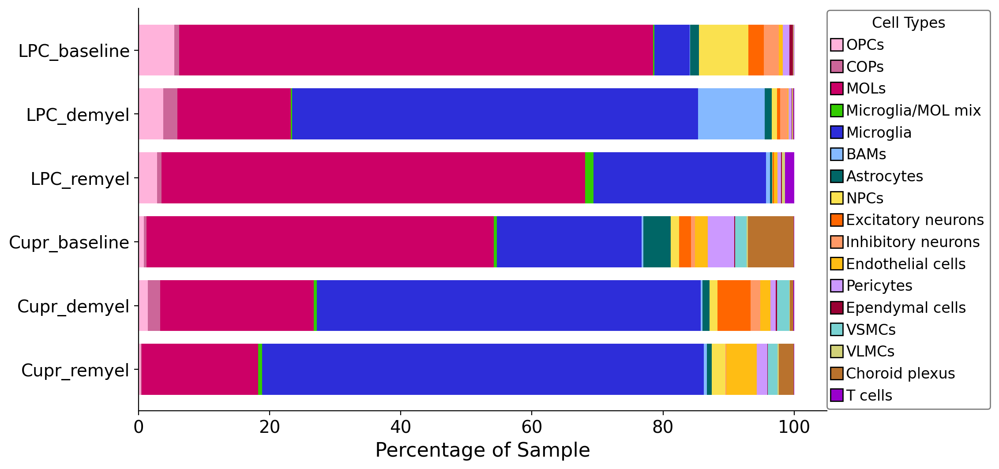

In [48]:
# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'Microglia': '#2d2dd9',
    'MOLs': '#cc0066',
    'BAMs': '#85b9ff',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia/MOL mix': '#33cc00',
    'NPCs': '#fae14f',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffbd14',
    'Pericytes': '#cc99ff',
    'Choroid plexus': '#b9722d',
    'Inhibitory neurons': '#ff9966',
    'Ependymal cells': '#990033',
    'T cells': '#9900cc',
    'VLMCs': '#d2d279',
    'VSMCs': '#79d2d2'
}

# Define the desired order of treatments and cell types
desired_cell_types_order_updated = ['OPCs', 'COPs', 'MOLs', 'Microglia/MOL mix', 'Microglia', 'BAMs', 'Astrocytes',
                            'NPCs', 'Excitatory neurons', 'Inhibitory neurons', 'Endothelial cells', 'Pericytes', 'Ependymal cells',
                                   'VSMCs', 'VLMCs', 'Choroid plexus', 'T cells']

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Show only x and y axis lines
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')


# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
#legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower left', fontsize=12, title='Cell Types')
legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='center left', fontsize=12, title='Cell Types', bbox_to_anchor=(1, 0.5), borderaxespad=0.)

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
plt.savefig('./figures/ALL_cell_types_stacked_barh.png', bbox_inches='tight', dpi=300)

# Show the plot
plt.show()

In [49]:
# Define the desired order of treatments and cell types
desired_treatments_order = ['LPC_baseline', 'LPC_demyel', 
                            'LPC_remyel', 'Cupr_baseline', 'Cupr_demyel', 'Cupr_remyel']

desired_cell_types_order = ['OPCs', 'COPs', 'MOLs', 'Microglia/MOL mix', 'Microglia', 'BAMs',
                            'Astrocytes', 'NPCs', 'Excitatory neurons', 'Inhibitory neurons',
                            'Endothelial cells', 'Pericytes', 'Ependymal cells', 'VSMCs', 'VLMCs', 
                            'Choroid plexus', 'T cells']


# Reorder the columns and the index of the percent_counts DataFrame
percent_counts_reordered = percent_counts_transposed[desired_cell_types_order].reindex(desired_treatments_order)

# Sum the counts of the specified cell types to create the 'other' category
percent_counts_reordered['Other'] = percent_counts_reordered[['Microglia/MOL mix', 'NPCs', 
                                                              'Excitatory neurons', 'Inhibitory neurons',
                                                              'Endothelial cells', 'Pericytes', 'Ependymal cells', 
                                                              'VSMCs', 'VLMCs', 'Choroid plexus', 
                                                              ]].sum(axis=1)

# Remove the individual cell type columns from the DataFrame
percent_counts_reordered.drop(columns=['Microglia/MOL mix', 'NPCs', 
                                                              'Excitatory neurons', 'Inhibitory neurons',
                                                              'Endothelial cells', 'Pericytes', 'Ependymal cells', 
                                                              'VSMCs', 'VLMCs', 'Choroid plexus', 
                                                              ], inplace=True)

# Reorder the columns of the DataFrame with the 'other' category included
desired_cell_types_order_updated = ['OPCs', 'COPs', 'MOLs','Microglia', 'BAMs','Astrocytes', 'T cells', 'Other']
percent_counts_reordered = percent_counts_reordered[desired_cell_types_order_updated]

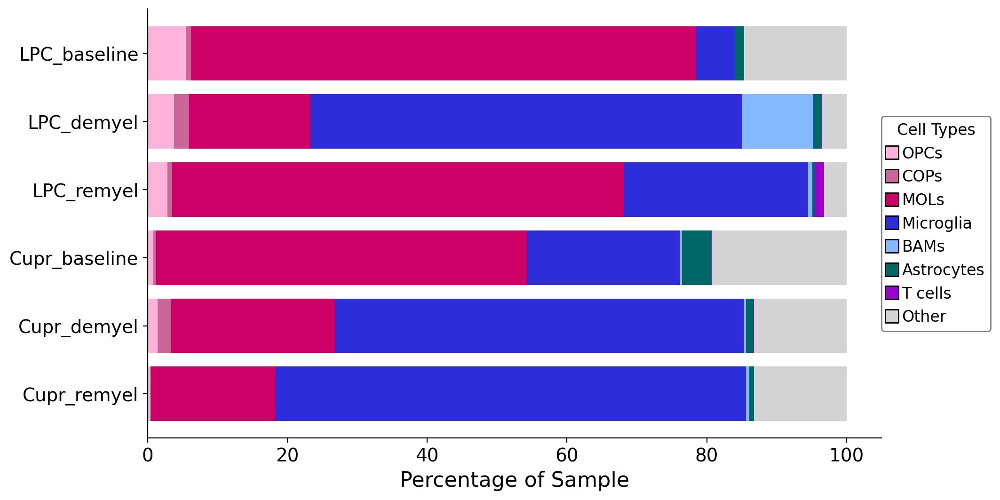

In [50]:
# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'Microglia': '#2d2dd9',
    'MOLs': '#cc0066',
    'BAMs': '#85b9ff',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia/MOL mix': '#33cc00',
    'NPCs': '#fae14f',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffbd14',
    'Pericytes': '#cc99ff',
    'Choroid plexus': '#b9722d',
    'Inhibitory neurons': '#ff9966',
    'Ependymal cells': '#990033',
    'T cells': '#9900cc',
    'VLMCs': '#d2d279',
    'VSMCs': '#79d2d2',
    'Other': '#d3d3d3'  # Light grey for the 'Other' category
}

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Show only x and y axis lines
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')

# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
#legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')
legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='center left', fontsize=12, title='Cell Types', bbox_to_anchor=(1, 0.5), borderaxespad=0.)

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
plt.savefig('./figures/cell_types_barh_NEW.png', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

In [53]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata_all.obs.groupby(['batch', 'cluster_annotation']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='cluster_annotation', columns='batch', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/1064779.1.gpu/ipykernel_13364/992399579.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata_all.obs.groupby(['batch', 'cluster_annotation']).size().reset_index(name='cell_count')


cluster_annotation,OPCs,COPs,MOLs,Microglia/MOL mix,Microglia,BAMs,Astrocytes,NPCs,Excitatory neurons,Inhibitory neurons,Endothelial cells,Pericytes,Ependymal cells,VSMCs,VLMCs,Choroid plexus,T cells
batch,,,,,,,,,,,,,,,,,
1,6.420878,9.776305,18.309859,0.911350,11.516156,0.041425,1.574151,1.035626,40.679370,8.657829,0.000000,0.041425,0.828500,0.000000,0.041425,0.041425,0.124275
2,6.818182,6.818182,29.545455,1.000000,34.818182,0.045455,3.318182,1.000000,9.681818,5.136364,0.045455,0.227273,1.000000,0.000000,0.045455,0.000000,0.500000
3,2.893726,1.075544,70.857875,0.332907,7.375160,0.051216,1.536492,5.044814,5.275288,5.249680,0.076825,0.102433,0.051216,0.000000,0.000000,0.025608,0.051216
4,2.634989,0.475162,68.164147,0.431965,7.386609,0.086393,2.289417,7.170626,6.522678,4.276458,0.043197,0.086393,0.302376,0.000000,0.043197,0.000000,0.086393
5,4.869518,2.098467,20.016142,0.376648,59.026096,4.492871,2.071563,1.748722,0.645682,4.062416,0.053807,0.080710,0.080710,0.000000,0.053807,0.080710,0.242131
6,5.759952,3.166466,23.462002,0.723764,54.010856,3.709288,2.714113,1.296743,2.442702,2.141134,0.060314,0.030157,0.030157,0.000000,0.000000,0.180941,0.271411
7,2.906209,1.188904,75.341259,0.220167,2.113606,0.000000,3.742845,2.950242,8.982827,2.113606,0.044033,0.044033,0.176134,0.000000,0.044033,0.132100,0.000000
8,4.578313,0.883534,68.192771,0.160643,1.044177,0.000000,5.381526,2.248996,11.646586,4.899598,0.000000,0.000000,0.803213,0.000000,0.000000,0.160643,0.000000
9,11.989319,0.827770,53.831776,0.000000,7.903872,0.053405,2.189586,18.397864,0.373832,1.308411,0.801068,1.094793,1.148198,0.000000,0.080107,0.000000,0.000000


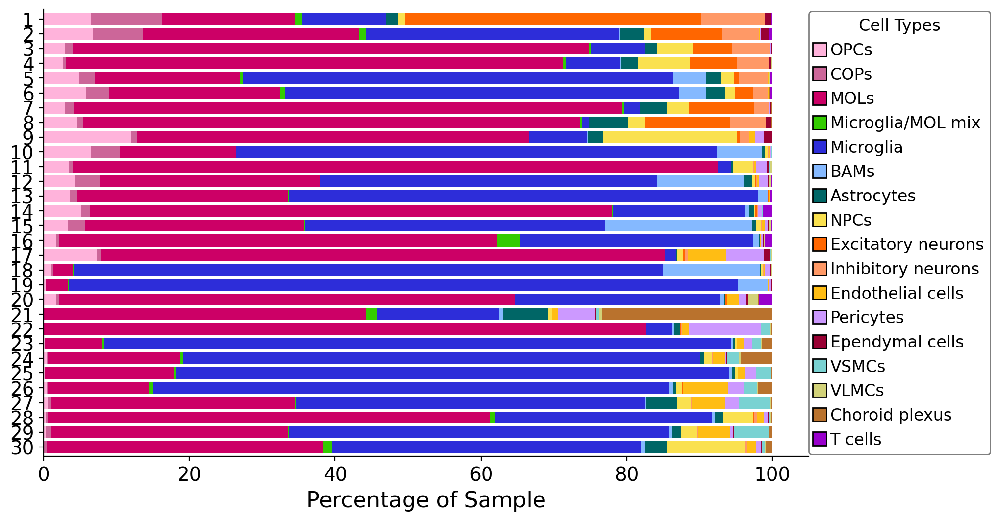

In [57]:
# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'Microglia': '#2d2dd9',
    'MOLs': '#cc0066',
    'BAMs': '#85b9ff',
    'OPCs': '#ffb3db',
    'COPs': '#cc6699',
    'Microglia/MOL mix': '#33cc00',
    'NPCs': '#fae14f',
    'Excitatory neurons': '#ff6600',
    'Astrocytes': '#006666',
    'Endothelial cells': '#ffbd14',
    'Pericytes': '#cc99ff',
    'Choroid plexus': '#b9722d',
    'Inhibitory neurons': '#ff9966',
    'Ependymal cells': '#990033',
    'T cells': '#9900cc',
    'VLMCs': '#d2d279',
    'VSMCs': '#79d2d2',
    'Other': '#d3d3d3'
}

# Define the desired order of treatments and cell types
desired_cell_types_order_updated = ['OPCs', 'COPs', 'MOLs', 'Microglia/MOL mix', 'Microglia', 'BAMs', 'Astrocytes',
                            'NPCs', 'Excitatory neurons', 'Inhibitory neurons', 'Endothelial cells', 
                                    'Pericytes', 'Ependymal cells',
                                   'VSMCs', 'VLMCs', 'Choroid plexus', 'T cells']

# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_transposed.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Show only x and y axis lines
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')


# Create legend with transparency
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_transposed.columns]
#legend = ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')
legend = ax.legend(legend_handles, percent_counts_transposed.columns, loc='center left', fontsize=12, title='Cell Types', bbox_to_anchor=(1, 0.5), borderaxespad=0.)

# Set transparency of the legend
legend.get_frame().set_alpha(0.5)  # Set alpha value for transparency (0.5 makes it semi-transparent)

# Optionally, add a border color for contrast
legend.get_frame().set_edgecolor('black')  # Set border color of the legend

# Save the plot as a PNG file
plt.savefig('./figures/ALL_cell_types_by_SAMPLE_stacked_barh.png', bbox_inches='tight', dpi=300)

# Show the plot
plt.show()

In [105]:
common_innate_immunity=[ 'Ifi47', 'Iigp1', 'Mdfic', 'Top2a', 'Dynlt1a', 'Lgals1', 'Cxcl10', 'Oasl1', 'Zbp1', 
                        'Dhx58', 'Trim25', 'Rsad2','Slfn9', 'Oas1a', 'Ifitm2', 'Bcl3', 'Ifi27l2a', 'Oasl2', 
                        'Irf7','Ifit1', 'Bst2', 'Isg15', 'Ifit3b', 'Ifit3','Ifitm3','Rtp4']

sc.tl.score_genes(adata_all, common_innate_immunity, score_name='common_innate_immunity_signature')

computing score 'common_innate_immunity_signature'
    finished: added
    'common_innate_immunity_signature', score of gene set (adata.obs).
    596 total control genes are used. (0:00:03)


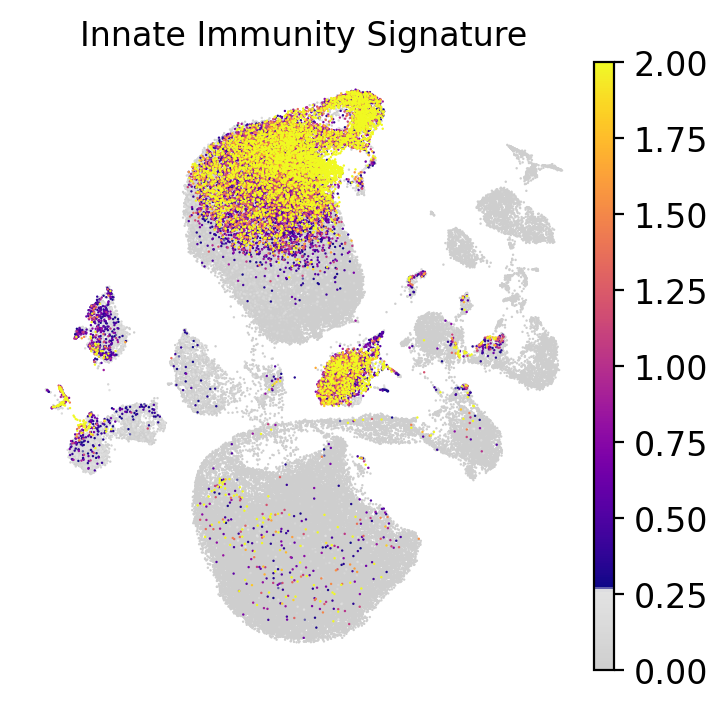

In [107]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['common_innate_immunity_signature'],legend_fontsize =float(12), 
           cmap=mymap2, vmin=0, vmax=2, s=3,
           legend_fontweight= 'normal', frameon= False, title='Innate Immunity Signature', save='innate_immune_signature.pdf' )

In [63]:
data_infmarkscore = pd.DataFrame({'condition': list(adata_all.obs['lesion_condition']),
                               'cell_type':list(adata_all.obs['cluster_annotation']),
                               'infmark':np.array(adata_all.obs['common_innate_immunity_signature'])
                              })

In [64]:
data_infmarkscore_set=data_infmarkscore.pivot_table(columns="condition", index="cell_type", values="infmark")
data_infmarkscore_set = data_infmarkscore_set.fillna(0)
data_infmarkscore_set

condition,LPC_demyelination,LPC_early_remyelination,LPC_late_remyelination,baseline,cuprizone_demyelination,cuprizone_remyelination
cell_type,,,,,,
Astrocytes,0.318219,0.473412,-0.015790,-0.151084,-0.095699,-0.138890
BAM,1.176641,0.845051,0.746184,0.293020,0.416147,0.334175
COPs,-0.457980,-0.287960,-0.407041,-0.389890,-0.104329,-0.259540
Choroid plexus,0.035906,0.000000,-0.308402,-0.007350,0.005012,-0.017121
Endothelial cells,1.578260,0.739933,0.835765,0.206804,0.224847,0.233697
Ependymal,0.409130,0.096799,0.687626,-0.178385,-0.077183,0.513212
Excitatory neurons,-0.452231,-0.322148,-0.988191,-0.392270,-0.181204,-0.369579
Inhibitory neurons,-0.539032,0.000000,-0.863255,-0.453774,-0.204430,-0.162662
MOL,-0.415327,-0.384954,-0.481796,-0.272267,-0.131004,-0.301450


In [65]:
data_infmarkscore_ord_transposed = data_infmarkscore_set.transpose()

In [66]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,10))
colorsComb = np.vstack([colors3, colors2])
mymapred = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

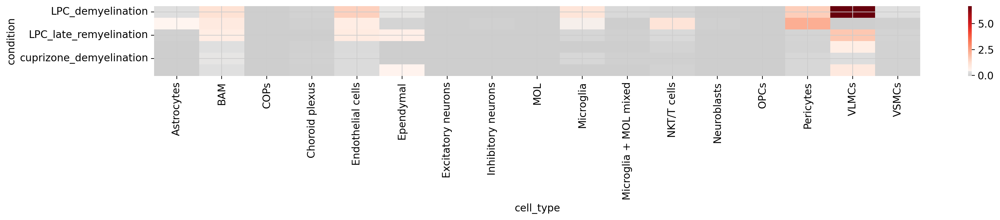

In [67]:
f, ax = plt.subplots(figsize=(20,1.5))
sb.heatmap(data_infmarkscore_ord_transposed, cmap=mymapred,annot=False, vmin=-0.05,linecolor='white')
plt.savefig('heatmap_immune_score2.pdf', dpi=300, bbox_inches = 'tight')

In [68]:
IRAS1=['Ccl2','Ccl20','Csf3','Cxcl1','Cxcl2','Cxcl3','Cxcl5','Fth1','Pdcd5','Pdlim4','Pitx3','Psme2','Serpine1','Sod2','Tnfaip6']
IRAS2=['B2m','Calr','Carhsp1','Ccl2','Cd47','Fth1','Icam1','Lap3','Nfkbia','Nnmt','Pdcd5','Pfn1','Pkm','Prelid1','Psme2','Sod2','Tmsb10','Vcam1'] #Leng et.al.2022

In [69]:
sc.tl.score_genes(adata_all, IRAS1, score_name='IRAS1')

computing score 'IRAS1'
    finished: added
    'IRAS1', score of gene set (adata.obs).
    347 total control genes are used. (0:00:02)


In [70]:
sc.tl.score_genes(adata_all, IRAS2, score_name='IRAS2')

computing score 'IRAS2'
    finished: added
    'IRAS2', score of gene set (adata.obs).
    299 total control genes are used. (0:00:02)


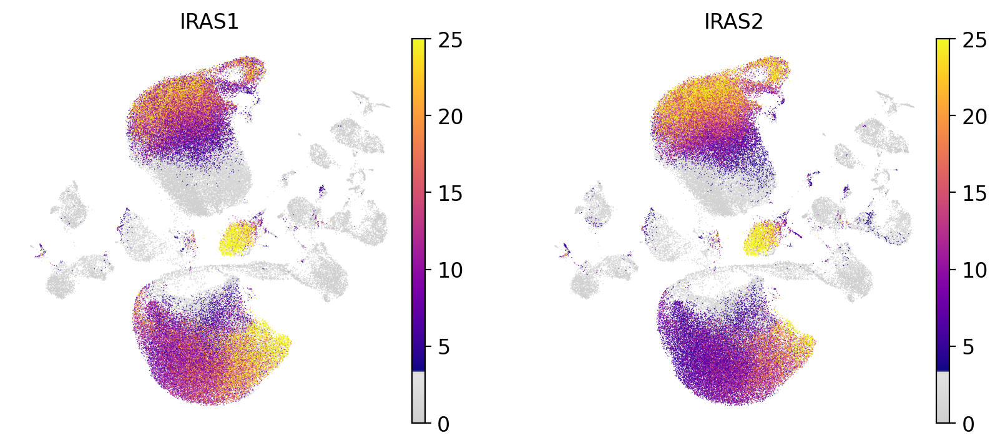

In [77]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['IRAS1', 'IRAS2'],legend_fontsize =float(12), cmap=mymap2, vmin=0, vmax=25, 
           legend_fontweight= 'normal', frameon= False) #save='Lenget.al.2022.pdf' )

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

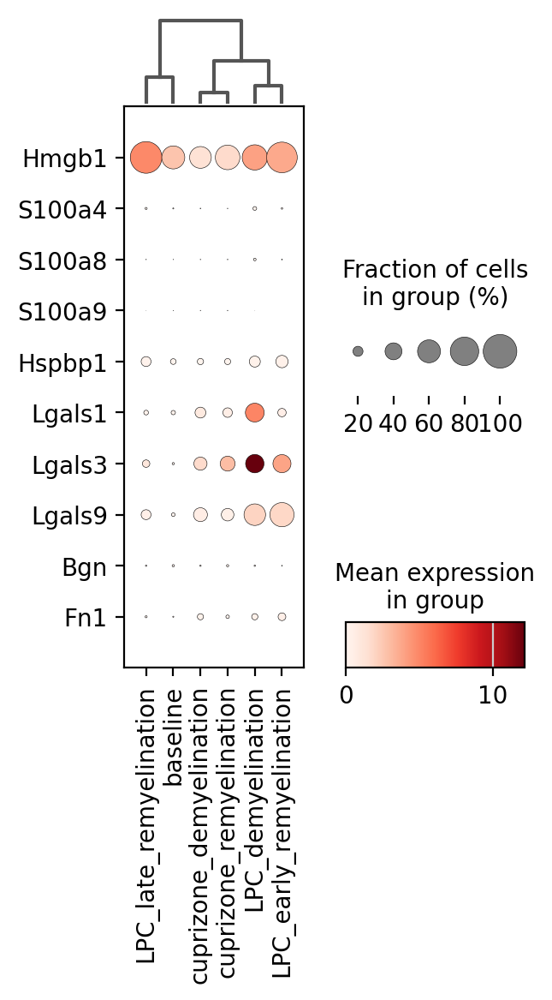

In [81]:
sc.pl.dotplot(adata_all, var_names=['Hmgb1', 'S100a4', 'S100a8', 'S100a9', 'Hspbp1',
                                   'Lgals1', 'Lgals3', 'Lgals9', 'Bgn', 'Fn1'], groupby='lesion_condition', swap_axes=True,
              dendrogram=True,figsize=(3,5)) #save='DAMPs_Yamaguchi_2020.pdf')

In [83]:
adata_all.write_h5ad('./mm_adata_all_annot_UPDATED.h5ad')

In [85]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['cell_leiden_annotated'].unique()
for condition in unique_conditions:
    print(condition)

16_Excitatory neurons

23_Inhibitory neurons

24_Inhibitory neurons

10_MOL

13_OPCs

20_COPs

4_Microglia

11_MOL

25_Microglia + MOL mixed

9_Microglia

14_Neuroblasts

2_Microglia

17_Astrocytes

7_MOL

12_BAM

27_Excitatory neurons

3_MOL

8_Microglia

1_MOL

0_Microglia

21_Microglia

5_MOL

29_Ependymal

26_Microglia

6_Microglia

18_Endothelial cells

28_NKT/T cells

19_Pericytes

15_Choroid plexus

31_VLMCs

30_Microglia

22_VSMCs

In [88]:
adata_all_astros = adata_all[np.in1d(adata_all.obs['cluster_annotation'], 
                           ['Astrocytes', 'Neuroblasts'])].copy()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


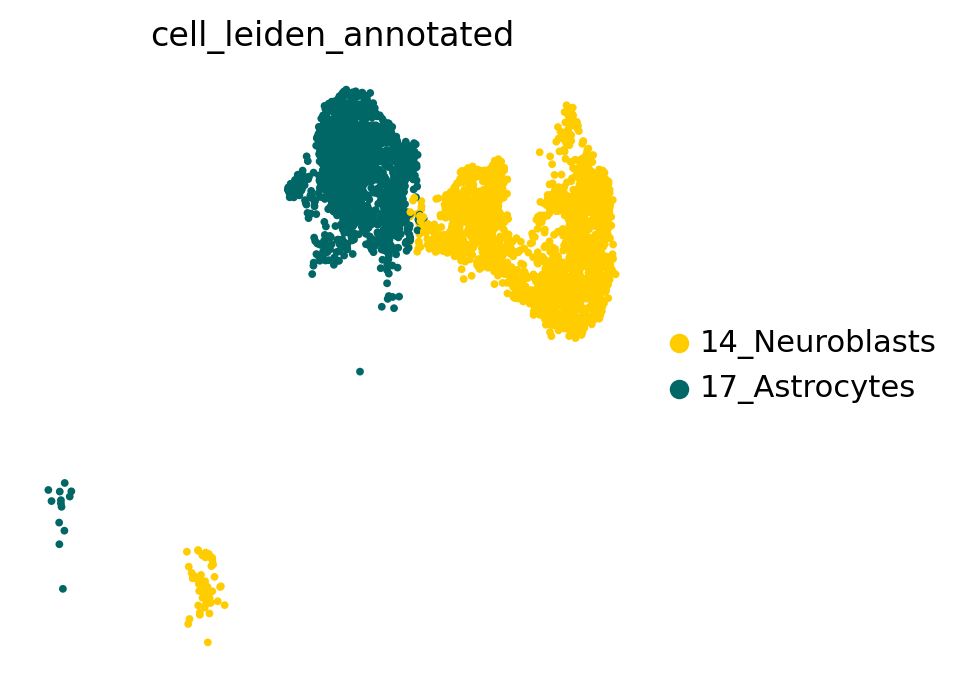

In [89]:
sc.pl.umap(adata_all_astros,color='cell_leiden_annotated', legend_fontweight= 'normal', frameon= False ,)

In [91]:
adata_all_oligos = adata_all[np.in1d(adata_all.obs['cluster_annotation'], 
                           ['MOL', 'OPCs','COPs'])].copy()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


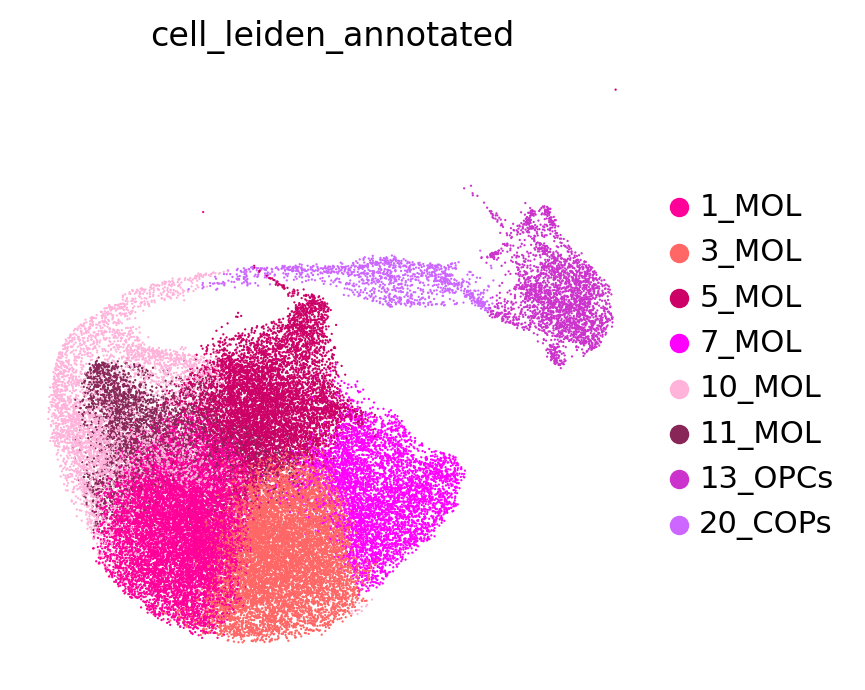

In [92]:
sc.pl.umap(adata_all_oligos,color='cell_leiden_annotated', legend_fontweight= 'normal', frameon= False ,)

In [93]:
adata_all_mg = adata_all[np.in1d(adata_all.obs['cluster_annotation'], 
                           ['Microglia', 'BAM'])].copy()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


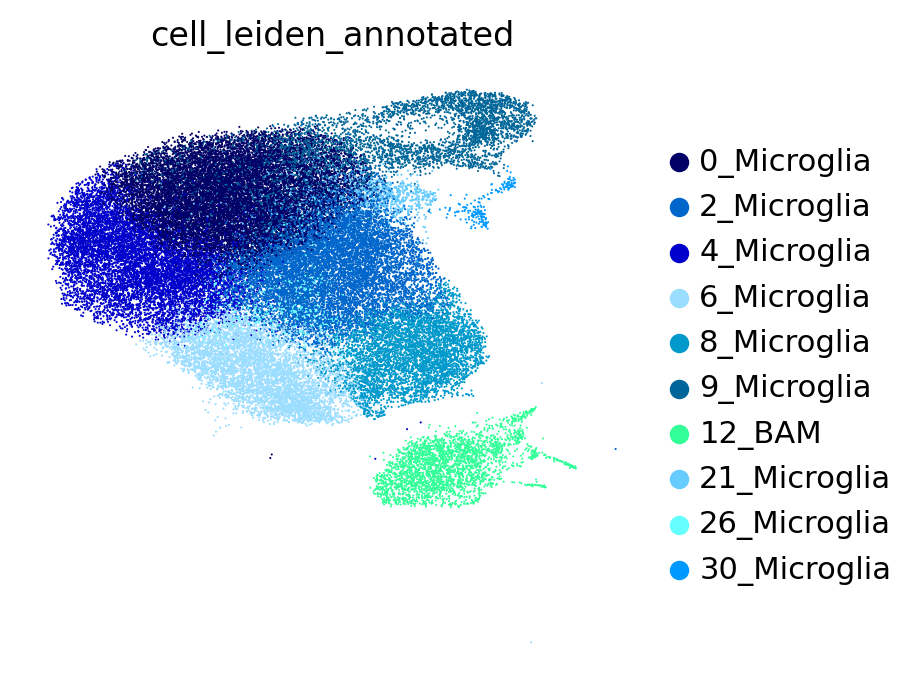

In [94]:
sc.pl.umap(adata_all_mg,color='cell_leiden_annotated', legend_fontweight= 'normal', frameon= False ,)

In [96]:
adata_all_astros.write_h5ad('./mm_adata_ASTR0_annot_UPDATED.h5ad')
adata_all_astros

AnnData object with n_obs × n_vars = 3826 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macrophage

In [97]:
adata_all_oligos.write_h5ad('./mm_adata_OLIGO_annot_UPDATED.h5ad')
adata_all_oligos

AnnData object with n_obs × n_vars = 44986 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macrophag

In [98]:
adata_all_mg.write_h5ad('./mm_adata_MG_annot_UPDATED.h5ad')
adata_all_mg

AnnData object with n_obs × n_vars = 53015 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macrophag

In [99]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all, groupby='cluster_annotation', key_added='rank_genes_annotated', 
                        method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_annotated']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:16)


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:419: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:419: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


In [103]:
sc.tl.dendrogram(adata_all, 'cluster_annotation')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cluster_annotation']`


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future vers

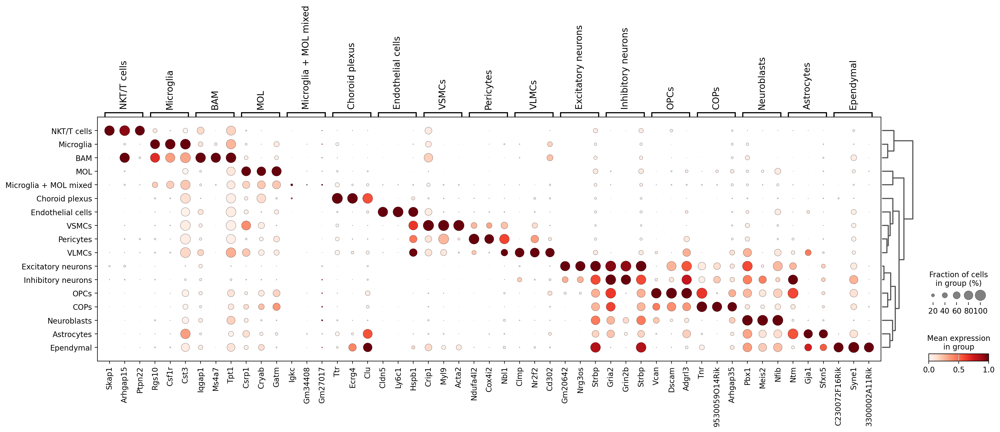

In [107]:
sc.pl.rank_genes_groups_dotplot(adata_all, n_genes=3, key='rank_genes_annotated',
                               standard_scale='var') #save='_scVI_ctrl_annotated.pdf')

In [108]:
result = adata_all.uns['rank_genes_annotated']
groups = result['names'].dtype.names
adata_annotated_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [109]:
adata_annotated_genes

,OPCs_n,OPCs_s,OPCs_p,OPCs_l,COPs_n,COPs_s,COPs_p,COPs_l,MOL_n,MOL_s,...,VLMCs_p,VLMCs_l,Choroid plexus_n,Choroid plexus_s,Choroid plexus_p,Choroid plexus_l,NKT/T cells_n,NKT/T cells_s,NKT/T cells_p,NKT/T cells_l
0,Vcan,56.501316,0.000000e+00,13.101054,Tnr,30.786795,1.485605e-155,50.189087,Csrp1,224.887207,...,8.447417e-34,9.408448,Ttr,61.007229,0.000000e+00,inf,Skap1,16.121309,2.205720e-38,14.026431
1,Dscam,56.404922,0.000000e+00,24.142603,9530059O14Rik,30.663948,5.420678e-154,17.902092,Cryab,214.838028,...,2.759252e-28,12.753716,Ecrg4,54.983444,0.000000e+00,22.220274,Arhgap15,15.723315,4.203543e-39,8.030134
2,Adgrl3,56.342628,0.000000e+00,16.068901,Arhgap35,30.281429,5.657127e-152,8.151553,Gatm,204.966751,...,6.813278e-28,6.697259,Clu,46.243710,0.000000e+00,15.594151,Ptpn22,14.980156,7.893421e-35,11.574085
3,Lsamp,55.395615,0.000000e+00,75.947388,Lsamp,29.724554,5.249648e-149,80.749664,Stmn4,203.163864,...,5.239853e-28,5.349929,Fxyd1,45.007828,1.871429e-303,12.938649,Itk,14.540145,1.907504e-33,14.500516
4,Nlgn1,55.286541,0.000000e+00,32.704983,Opcml,29.258837,4.363416e-144,77.326172,Car2,201.930557,...,4.275514e-27,30.986677,Chchd10,44.726120,2.308787e-298,16.717386,Vps37b,13.986251,7.767439e-32,14.176412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23655,Bin1,-33.884636,3.573699e-211,-7.804232,Selenop,-22.385748,1.281749e-93,-12.026505,C1qb,-167.531937,...,1.789483e-14,-8.041844,Litaf,-31.804695,1.418818e-179,-7.269711,Rhob,-10.383216,1.343100e-20,-11.489593
23656,Glul,-34.855446,7.600327e-221,-8.853042,Retreg1,-22.417471,3.401940e-95,-4.708650,Fcgr3,-167.774246,...,2.804501e-15,-6.133195,Luc7l2,-32.406715,8.822021e-187,-4.883089,Evi2a,-10.422264,9.301419e-21,-6.616011
23657,Litaf,-35.591286,1.199591e-230,-5.982257,Glul,-23.412355,4.856908e-101,-8.520521,Cst3,-170.093506,...,1.885373e-15,-5.003942,Foxn3,-34.185543,2.597327e-201,-7.763533,Lamp1,-10.510569,5.506016e-21,-16.024860
23658,Evi2a,-37.766369,2.362227e-251,-6.988503,Evi2a,-25.123903,1.997985e-113,-6.271229,Unc93b1,-172.473618,...,3.652196e-16,-8.304914,Son,-35.031086,1.542882e-215,-4.671488,Cd81,-10.521402,5.110519e-21,-20.808249


In [110]:
adata_annotated_genes.to_csv('./mm_adata_all_annotated_rank_genes.csv')

# Control figures

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


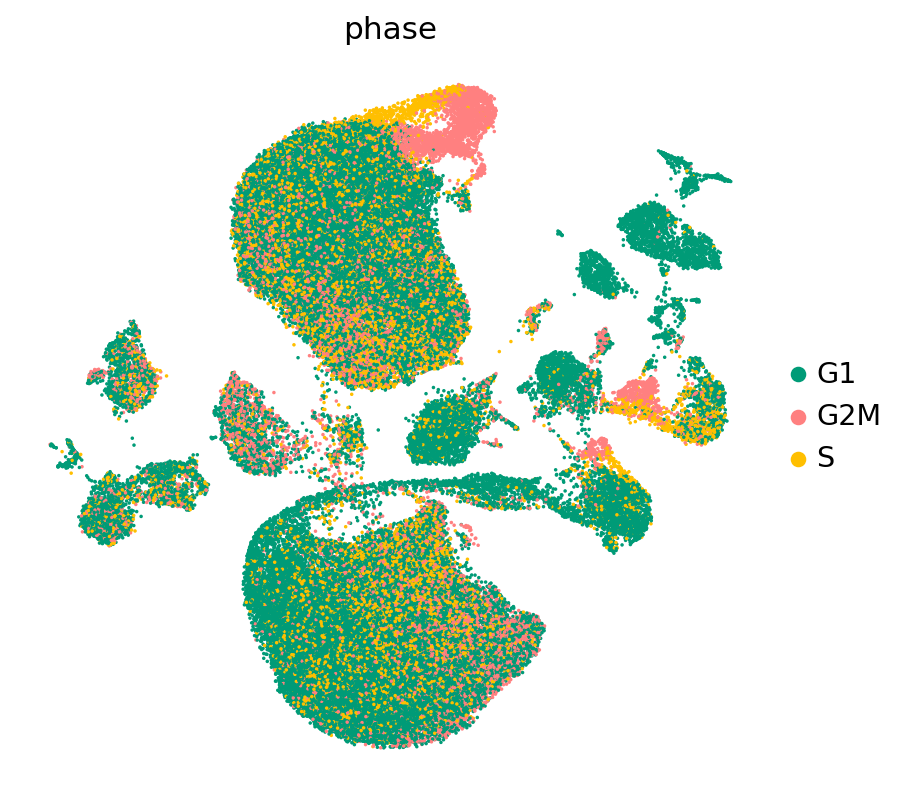

In [69]:
# Create a UMAP plot with adjusted parameters
sc.set_figure_params(dpi_save=300, figsize=(6, 6), transparent=True)  # High resolution and bigger figure size

pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]

sc.pl.umap(adata_all, color=['phase'],palette=pair2, use_raw=False, s=10,
           frameon=False, cmap=mymap2, ncols=1, save='sysVI_all_data_cell_cycle.png')

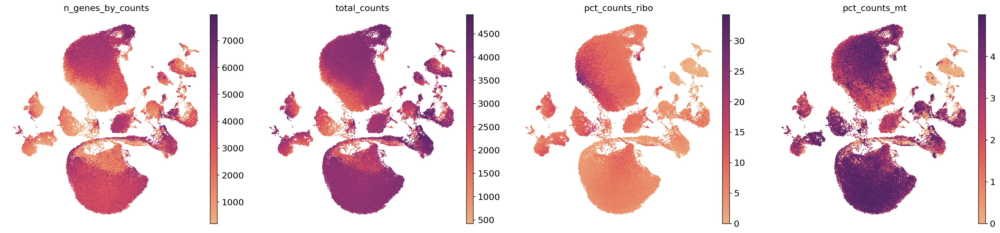

In [72]:
# Set figure parameters for high-resolution display and saving
sc.set_figure_params(dpi_save=300, figsize=(6, 6), transparent=True)

sc.pl.umap(adata_all, color=['n_genes_by_counts', 'total_counts', 
                         'pct_counts_ribo','pct_counts_mt'],
           cmap='flare',ncols=4, s=10, frameon=False,
          save='_sysVI_ALL_integration_QC_plots_reduced.png')

In [114]:
adata_all.write_h5ad('./mm_adata_all_annot_UPDATED.h5ad')
adata_all

AnnData object with n_obs × n_vars = 112017 × 23660
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'system_map', 'sys_leiden_0.5', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'lesion_status', 'lesion_condition', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Microglia', 'DAM', 'Macropha